In [ ]:
#from google.colab import drive
#drive.mount('/content/drive')
#!python /content/drive/MyDrive/DL/materials/materials/cropandweed-dataset-main2/cropandweed-dataset-main/cnw/setup.py

# CNN Approach using Classification and Sliding Window

## Setup

In [ ]:
label_folder = "/data/bboxes/CropOrWeed2"
images_folder = "/data/images"

with open('/data/train_split.txt') as f:
    lines = f.readlines()

### Support Functions

#### Visualization Function for Image with Bounding Boxes

This Python function is designed to visualize an image with bounding boxes. It takes the file paths of an image and a CSV file containing bounding box coordinates and labels. The function reads the image and bounding box information from the CSV file, then displays the image with bounding boxes using matplotlib.

- **Parameters:**
  - `image_path`: File path of the input image.
  - `csv_path`: File path of the CSV file containing bounding box coordinates and labels.

- **Steps:**
  1. Read the input image using the PIL library.
  2. Read the CSV file containing bounding box information using pandas.
  3. Create a matplotlib Figure and Axes for visualization.
  4. Display the image on the Axes.
  5. Add a grid of 100x100 pixel squares to the Axes.
  6. Iterate over the rows of the DataFrame to draw bounding boxes on the image.
  7. For each bounding box, create a rectangle and add it to the Axes.
  8. Add label information to the rectangle (Label ID).
  9. Show the image with bounding boxes using matplotlib.

- **Note:**
  - The color of the bounding boxes is determined based on the label ID (green for label 0, red for other labels).



In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import pandas as pd
from PIL import Image

def visualizza_immagine_con_bbox(image_path, csv_path):
    # Read the image
    img = Image.open(image_path)
    # Read the CSV file containing bounding boxes
    df = pd.read_csv(csv_path, names=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

    # Create a Figure and Axes object
    fig, ax = plt.subplots(1)

    # Display the image
    ax.imshow(img)

    # Add a grid of 100x100 pixels
    ax.set_xticks(range(0, img.width, 256))
    ax.set_yticks(range(0, img.height, 256))
    ax.grid(which='both', color='white', linewidth=1)

    # Iterate over the rows of the DataFrame
    for index, row in df.iterrows():
        # Get bounding box coordinates
        left, top, right, bottom, label_id = row['Left'], row['Top'], row['Right'], row['Bottom'], row['Label']

        if label_id == 0:
          color = 'g'
        else:
          color = 'r'

        # Calculate width and height
        width = right - left
        height = bottom - top

        # Create a bounding box rectangle
        rect = patches.Rectangle((left, top), width, height, linewidth=2, edgecolor=color, facecolor='none')

        # Add the rectangle to the Axes
        ax.add_patch(rect)

        # Add text (Label ID) to the rectangle
        ax.text(left, top - 5, f'Label: {label_id}', color=color, fontsize=8, fontweight='bold')

    # Show the image with bounding boxes
    plt.show()

This Python function is an updated version of the previous visualization function. Instead of reading the bounding box information from a CSV file, it takes a DataFrame (`df`) directly as an argument. This allows more flexibility in using the function with preprocessed data or predictions.

- **Parameters:**
  - `image_path`: File path of the input image.
  - `df`: DataFrame containing bounding box coordinates and labels.

- **Changes:**
  - The function now takes a DataFrame (`df`) as an argument instead of reading from a CSV file.
  - The grid size in the visualization is adjusted to 50x50 pixels for better display.



In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import pandas as pd
from PIL import Image

def visualizza_immagine_con_bbox2(image_path, df):
    # Leggi l'immagine
    img = Image.open(image_path)

    # Crea un oggetto Figure e un oggetto Axes
    fig, ax = plt.subplots(1)

    # Visualizza l'immagine
    ax.imshow(img)

    # Aggiungi una griglia di 100x100 pixel
    ax.set_xticks(range(0, img.width, 50))
    ax.set_yticks(range(0, img.height, 50))
    ax.grid(which='both', color='white', linewidth=1)


    # Itera sulle righe del DataFrame
    for index, row in df.iterrows():
        # Ottieni le coordinate delle bounding boxes
        left, top, right, bottom, label_id= row['Left'], row['Top'], row['Right'], row['Bottom'], row['Label']

        if label_id == 0:
          color = 'g'
        else:
          color = 'r'

        # Calcola larghezza e altezza
        width = right - left
        height = bottom - top

        # Crea un rettangolo della bounding box
        rect = patches.Rectangle((left, top), width, height, linewidth=2, edgecolor=color, facecolor='none')

        # Aggiungi il rettangolo all'oggetto Axes
        ax.add_patch(rect)

        # Aggiungi il testo (Label ID) al rettangolo
        ax.text(left, top - 5, f'Label: {label_id}', color=color, fontsize=8, fontweight='bold')

    # Mostra l'immagine con le bounding boxes
    plt.show()

#### Bounding Box Matrix Creation Function


This Python function reads bounding box information from a CSV file and creates matrices with zeros and ones, where ones represent the presence of bounding boxes in specific regions of the image.

- **Parameters:**
  - `csv_path`: File path of the CSV file containing bounding box information.
  - `dimensione_box`: Size of the boxes used to create matrices.

- **Output:**
  - A list containing two matrices (`matrice_label0` and `matrice_label1`) where ones represent the presence of bounding boxes labeled as 0 and 1, respectively.



In [ ]:
import pandas as pd
import numpy as np

def crea_matrici_da_bbox(csv_path, dimensione_box):

    # Read the CSV file containing bounding boxes
    df = pd.read_csv(csv_path, names=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

    # Initialize matrices with zeros
    matrice_label0 = np.zeros((1088 // dimensione_box + 1, 1920 // dimensione_box + 1), dtype=int)
    matrice_label1 = np.zeros((1088 // dimensione_box + 1, 1920 // dimensione_box + 1), dtype=int)

    # Iterate over the rows of the DataFrame
    for index, row in df.iterrows():
        # Get bounding box coordinates
        left, top, right, bottom = row['Left'], row['Top'], row['Right'], row['Bottom']

        # Calculate the index of the cell in the matrix
        col_start_index = left // dimensione_box
        col_end_index = right // dimensione_box + 1
        row_start_index = top // dimensione_box
        row_end_index = bottom // dimensione_box + 1

        for i in range(col_start_index, col_end_index):
            for j in range(row_start_index, row_end_index):
                if row['Label'] == 0:
                    matrice_label0[j, i] = 1
                if row['Label'] == 1:
                    matrice_label1[j, i] = 1

    return [matrice_label0, matrice_label1]

#### Bounding Box Creation Function from Matrices


This Python function takes matrices with ones representing the presence of bounding boxes and creates a DataFrame with bounding box coordinates.

- **Parameters:**
  - `matrici`: List of matrices where ones represent the presence of bounding boxes for different labels.
  - `dimensione_box`: Size of the boxes used to create bounding boxes.

- **Output:**
  - A DataFrame containing bounding box coordinates (`Left`, `Top`, `Right`, `Bottom`) and labels (`Label`).



In [ ]:
import pandas as pd
from skimage import measure

def create_bbbox_from_matrix(matrici,dimensione_box):

  bbox_list = []

  for i in range(len(matrici)):

    ID = i

    # Assuming labeled_image is the result from skimage.measure.label
    labeled_image = measure.label(matrici[i])

    # Use measure.regionprops to get bounding box coordinates
    regions = measure.regionprops(labeled_image)

    # Create a list to store bounding box coordinates
    # Iterate through regions and extract bounding box coordinates
    for region in regions:
        minr, minc, maxr, maxc = region.bbox
        bbox_list.append([minc*dimensione_box, minr*dimensione_box, maxc*dimensione_box, maxr*dimensione_box,ID])



  # Create a DataFrame from the list
  columns = ["Left", "Top", "Right", "Bottom", "Label"]
  df = pd.DataFrame(bbox_list, columns=columns)
  return df


#### Folder Deletion Function

This Python function deletes a folder and its contents.

- **Parameters:**
  - `folder_path`: Path of the folder to be deleted.

- **Output:**
  - Prints a success message if the folder is deleted successfully.
  - Prints an error message if there is an issue with the deletion.


In [ ]:
import shutil
import os

def delete_folder(folder_path):
    try:
        shutil.rmtree(folder_path)
        print(f"Successfully deleted the folder: {folder_path}")
    except Exception as e:
        print(f"Error deleting the folder: {e}")

#### Image Division Function

This Python function divides an image into smaller blocks based on bounding box information from a CSV file.

- **Parameters:**
  - `input_path`: Path of the input image.
  - `output_directory`: Directory to save the divided blocks.
  - `csv_path`: Path of the CSV file containing bounding box information.
  - `dimensione_blocco`: Size of each block.

- **Output:**
  - Saves divided blocks into separate directories based on the class.


In [ ]:
dimensione_box = 100

from PIL import Image
import os

def divide_immagine(input_path, output_directory,csv_path, dimensione_blocco=100):
    # Open the image
    immagine = Image.open(input_path)

    # Get the dimensions of the image
    larghezza, altezza = immagine.size

    # Create matrices from bounding box information
    M = crea_matrici_da_bbox(csv_path, dimensione_blocco)

    # Iterate through the image and create smaller images
    for y in range(0, altezza, dimensione_blocco):
        for x in range(0, larghezza, dimensione_blocco):
            d = ""
            box = (x, y, x + dimensione_blocco, y + dimensione_blocco)
            blocco = immagine.crop(box)

            # Create a unique name for the block
            nome_blocco = os.path.splitext(os.path.basename(input_path))[0] + f"_block_{y//dimensione_blocco}_{x//dimensione_blocco}.jpg"

            if M[0][y//dimensione_blocco][x//dimensione_blocco] == 1:
                # Class 0
                d = os.path.join(output_directory, "class0")
                blocco.save(os.path.join(d, nome_blocco))
            elif M[1][y//dimensione_blocco][x//dimensione_blocco] == 1:
                # Class 1
                d = os.path.join(output_directory, "class1")
                blocco.save(os.path.join(d, nome_blocco))
            else:
                # Class 2
                d = os.path.join(output_directory, "class2")
                blocco.save(os.path.join(d, nome_blocco))


#### Extract Bounding Boxes for Training Function

This Python function takes an input image, extracts bounding boxes based on the provided CSV file, and saves the cropped images to a specified output directory.

- **Parameters:**
  - `input_path`: Path to the input image.
  - `output_image_directory`: Directory where cropped images will be saved.
  - `csv_path`: Path to the CSV file containing bounding box information.

- **Output:**
  - Cropped images saved in the specified output directory.


In [ ]:
def ottieni_box_per_train(input_path, output_image_directory, csv_path):
    # Open the image
    immagine = Image.open(input_path)

    # Read the CSV file containing bounding boxes
    df = pd.read_csv(csv_path, names=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

    # Iterate through rows in the DataFrame
    for i, riga in df.iterrows():
        # Create a directory based on the label
        direc = os.path.join(output_image_directory, f"class{riga['Label']}")

        # Create a unique name for the cropped image
        nome_blocco = os.path.splitext(os.path.basename(input_path))[0] + f"_{i}.jpg"

        # Extract bounding box coordinates
        left, top, right, bottom = riga["Left"], riga["Top"], riga["Right"], riga["Bottom"]

        # Crop the image based on bounding box coordinates
        cropped_image = immagine.crop((left, top, right, bottom))

        # Save the cropped image to the specified directory
        cropped_image.save(os.path.join(direc, nome_blocco))


## Create Dataset

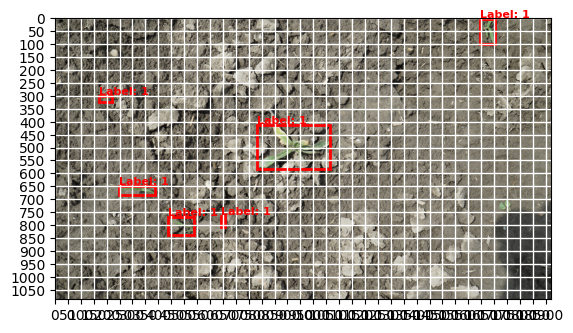

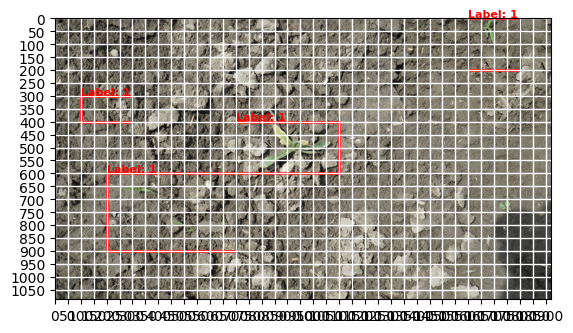

In [ ]:
import random

# Chiama la funzione per visualizzare l'immagine con le bounding boxes
for i in range(1):

  random_number = random.randint(0, len(lines))

  # Sostituisci con il percorso dell'immagine e del file CSV
  immagine_path = images_folder + "/" + lines[random_number][:-1]+".jpg"
  csv_path = label_folder + "/" + lines[random_number][:-1]+".csv"

  dimensione_box = 100

  visualizza_immagine_con_bbox(immagine_path, csv_path)
  df = create_bbbox_from_matrix(crea_matrici_da_bbox(csv_path,dimensione_box),dimensione_box)
  visualizza_immagine_con_bbox2(immagine_path, df)

### Create folder structure

In [ ]:
import os
import re

for name in ['train','test']:

  with open(f'/data/{name}_split.txt') as f:
    lines = f.readlines()

  output_image_directory = f"/data/{name}ing_images"

  folder_to_delete = f"/data/{name}ing_images"
  delete_folder(folder_to_delete)

  # Verifica se l'output_directory esiste, altrimenti crealo

  if not os.path.exists(output_image_directory):
    os.makedirs(output_image_directory)

  if not os.path.exists(output_image_directory + "/class0"):
      os.makedirs(output_image_directory + "/class0")
  if not os.path.exists(output_image_directory + "/class1"):
      os.makedirs(output_image_directory + "/class1")
  if not os.path.exists(output_image_directory + "/class2"):
      os.makedirs(output_image_directory + "/class2")

  number_of_images = len(lines) - 1

  for i in range(number_of_images):
    input_path = images_folder + "/" + lines[i][:-1]+".jpg"
    csv_path = label_folder + "/" + lines[i][:-1]+".csv"
    divide_immagine(input_path, output_image_directory,csv_path)
    print(i, input_path)



  for cartella in [f'/data/{name}ing_images/class0', f'/data/{name}ing_images/class1', f'/data/{name}ing_images/class2'] :

    # Espressione regolare per estrarre il nome dal formato fornito
    pattern = re.compile(r'^([a-zA-Z0-9-]+)')

    # Lista di tutti i file nella cartella
    files = [f for f in os.listdir(cartella) if os.path.isfile(os.path.join(cartella, f))]

    L = []
    # Estrai e stampa i nomi
    for file in files:
        match = pattern.match(file)
        if match:
            nome = match.group(1)
            L.append(nome)
    set_res = set(L)
    list_res = (list(set_res))
    print(f"The unique elements of {cartella}:",len(list_res),"\n")


In [ ]:
#training 2 version

for name in ['train']:

  with open(f'/data/{name}_split.txt') as f:
    lines = f.readlines()

  output_image_directory = f"/data/{name}ing_images2"

  folder_to_delete = f"/data/{name}ing_images2"
  delete_folder(folder_to_delete)

  # Verifica se l'output_directory esiste, altrimenti crealo

  if not os.path.exists(output_image_directory):
    os.makedirs(output_image_directory)

  if not os.path.exists(output_image_directory + "/class0"):
      os.makedirs(output_image_directory + "/class0")
  if not os.path.exists(output_image_directory + "/class1"):
      os.makedirs(output_image_directory + "/class1")
  if not os.path.exists(output_image_directory + "/class2"):
      os.makedirs(output_image_directory + "/class2")

  number_of_images = len(lines) - 1

  for i in range(number_of_images):
    input_path = images_folder + "/" + lines[i][:-1]+".jpg"
    csv_path = label_folder + "/" + lines[i][:-1]+".csv"
    ottieni_box_per_train(input_path, output_image_directory,csv_path)
    #print(i, input_path)

  files0 = [f for f in os.listdir(f'/data/{name}ing_images2/class0') if os.path.isfile(os.path.join(f'/data/{name}ing_images2/class0', f))]
  files1 = [f for f in os.listdir(f'/data/{name}ing_images2/class1') if os.path.isfile(os.path.join(f'/data/{name}ing_images2/class1', f))]
  max_num = max(len(files0),len(files1))
  print(f"Elements of /data/{name}ing_images2/class0:",len(files0))
  print(f"Elements of /data/{name}ing_images2/class1:",len(files1))

  input_directory = f'/data/{name}ing_images/class2'
  output_directory = f'/data/{name}ing_images2/class2'

  for i in range(max_num):
    elenchi_file = os.listdir(input_directory)
    file_casuale = random.choice(elenchi_file)
    percorso_input = os.path.join(input_directory, file_casuale)
    percorso_output = os.path.join(output_directory, file_casuale)
    shutil.copy(percorso_input, percorso_output)

  files2 = [f for f in os.listdir(output_directory) if os.path.isfile(os.path.join(output_directory, f))]
  print(f"Elements of {output_directory}:",len(files2))

Error deleting the folder: [Errno 2] No such file or directory: '/data/training_images2'
Elements of /data/training_images2/class0: 628
Elements of /data/training_images2/class1: 1934
Elements of /data/training_images2/class2: 1830


Data argumentation

In [ ]:
from torchvision import transforms

files0 = [f for f in os.listdir(f'/data/{name}ing_images2/class0') if os.path.isfile(os.path.join(f'/data/{name}ing_images2/class0', f))]

if len(files0) < len(files1):
  i = 0
  F = files0
else:
  i = 1
  F = files1

diff = abs(len(files0) - len(files1))

for j in range(diff):

  random_number = random.randint(0, len(F)-1)

  img = Image.open(f'/data/{name}ing_images2/class{i}/' + F[random_number])

  trasformazioni = transforms.Compose([
      transforms.RandomHorizontalFlip(),
      transforms.RandomRotation(10),
      transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
  ])

  img2 = trasformazioni(img)
  img2.save(f'/data/{name}ing_images2/class{i}/' + F[random_number][:-4] + "_mod_"+ f"{j}" +".jpg")




In [ ]:
files0 = [f for f in os.listdir(f'/data/{name}ing_images2/class0') if os.path.isfile(os.path.join(f'/data/{name}ing_images2/class0', f))]
files1 = [f for f in os.listdir(f'/data/{name}ing_images2/class1') if os.path.isfile(os.path.join(f'/data/{name}ing_images2/class1', f))]
files2 = [f for f in os.listdir(output_directory) if os.path.isfile(os.path.join(output_directory, f))]

print(f"Elements of /data/{name}ing_images2/class0:",len(files0))
print(f"Elements of /data/{name}ing_images2/class1:",len(files1))
print(f"Elements of {output_directory}:",len(files2))

Elements of /data/training_images2/class0: 1934
Elements of /data/training_images2/class1: 1934
Elements of /data/training_images2/class2: 1830


## Create DataLoader

In [ ]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import glob as gb
from tqdm.auto import tqdm
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import Adam , lr_scheduler
import torchvision
from torchvision import datasets
import torchvision.transforms as transforms
from torchvision.transforms import ToTensor
from torch.utils.data import DataLoader , Dataset
from mlxtend.plotting import plot_confusion_matrix

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score , precision_score , recall_score , f1_score

In [ ]:
def walk_through_data(dir_path) :
    for dirpath , dirnames , filenames in tqdm(os.walk(dir_path)) :
        print(f"There are {len(dirnames)} directions and {len(filenames)} images in {dirpath}")

In [ ]:
def getlabel(n) :
    for x , y in class_labels.items() :
        if n==y :
            return x

In [ ]:
img_size = 100

#### Create path list

In [ ]:
# TRAIN

dataset_path = "/data/training_images2"

walk_through_data(dataset_path)

extension = []
classes = []

for folder in tqdm(os.listdir(dataset_path)) :
    if folder not in classes :
        classes.append(folder)

    for file in os.listdir(dataset_path + "/" + folder + "/") :
        if os.path.isfile(dataset_path + "/" + folder + "/" + file) :
            extension.append(os.path.splitext(file)[1])

print(len(extension) , np.unique(extension))
len(classes)

class_labels = {key : value for value , key in enumerate(classes)}
class_labels

train_path_list = []
train_labels = []

for folder in tqdm(os.listdir(dataset_path)) :
    files = gb.glob(pathname = str(dataset_path + "/" + folder + "/*.jpg"))
    for file in files :
        train_path_list.append(file)
        train_labels.append(class_labels[folder])

In [ ]:
# TEST

dataset_path = "/data/testing_images"

walk_through_data(dataset_path)

extension = []
classes = []

for folder in tqdm(os.listdir(dataset_path)) :
    if folder not in classes :
        classes.append(folder)

    for file in os.listdir(dataset_path + "/" + folder + "/") :
        if os.path.isfile(dataset_path + "/" + folder + "/" + file) :
            extension.append(os.path.splitext(file)[1])

print(len(extension) , np.unique(extension))
len(classes)

class_labels = {key : value for value , key in enumerate(classes)}
class_labels

test_path_list = []
test_labels = []

for folder in tqdm(os.listdir(dataset_path)) :
    files = gb.glob(pathname = str(dataset_path + "/" + folder + "/*.jpg"))
    for file in files :
        test_path_list.append(file)
        test_labels.append(class_labels[folder])

In [ ]:
len(train_path_list) , len(train_labels) , len(test_path_list) , len(test_labels)

(5698, 5698, 22000, 22000)

#### Define Transformation

In [ ]:
basic_transform_on_train = transforms.Compose([
    torchvision.transforms.Resize(size = (img_size , img_size)),
    torchvision.transforms.ColorJitter(hue=.05, saturation=.05),
    torchvision.transforms.RandomHorizontalFlip(),
    torchvision.transforms.RandomRotation(20),
    transforms.ToTensor()
])

In [ ]:
basic_transform = transforms.Compose([
    transforms.Resize(size = (img_size , img_size)) ,
    transforms.ToTensor()
])

#### Train Set

In [ ]:
class InvalidDatasetException(Exception):

    def __init__(self,len_of_paths,len_of_labels):
        super().__init__(
            f"Number of paths ({len_of_paths}) is not compatible with number of labels ({len_of_labels})"
        )

In [ ]:
class train_data(Dataset) :
    def __init__(self , train_path , train_label , transform_method) :
        self.train_path = train_path
        self.train_label = train_label
        self.transform = transform_method
        if len(self.train_path) != len(self.train_label) :
            raise InvalidDatasetException(self.train_path,self.train_label)


    def __len__(self) :
        return len(self.train_path)


    def __getitem__(self,index) :
        image = Image.open(self.train_path[index])
        tensor_image = self.transform(image)
        label = self.train_label[index]

        return tensor_image , label


In [ ]:
train_set = train_data(train_path_list , train_labels , basic_transform_on_train)

In [ ]:
from collections import Counter
# Count occurrences using Counter
counted_elements = Counter(train_labels)

# Print the result
print(counted_elements)

Counter({1: 1934, 2: 1934, 0: 1830})


In [ ]:
print(f"The number of images in the train set is : {train_set.__len__()}")
filer_train_image=train_set.__getitem__(4)
filer_train_image[0].shape

The number of images in the train set is : 5698


torch.Size([3, 100, 100])

#### Test Set

In [ ]:
class test_data(Dataset) :
    def __init__(self,test_path , test_label , transform_method) :
        self.test_path = test_path
        self.test_label = test_label
        self.transform = transform_method
        if len(self.test_path) != len(self.test_label) :
            raise InvalidDatasetException(self.test_path , self.test_label)


    def __len__(self) :
        return len(self.test_path)


    def __getitem__(self,index) :
        image = Image.open(self.test_path[index])
        tensor_image = self.transform(image)
        label = self.test_label[index]

        return tensor_image , label

In [ ]:
test_set = test_data(test_path_list , test_labels , basic_transform)
np.unique(test_set.test_label)
print(f"The number of images in the train set is : {test_set.__len__()}")
filer_test_image=test_set.__getitem__(4)
filer_test_image[0].shape

The number of images in the train set is : 22000


torch.Size([3, 100, 100])

#### Create Data Loaders

In [ ]:
BATCH_SIZE = 4

In [ ]:
torch.manual_seed(42)
train_dataloader = DataLoader(
    dataset = train_set ,
    batch_size = BATCH_SIZE ,
    shuffle = True
)

In [ ]:
torch.manual_seed(42)
test_dataloader = DataLoader(
    dataset = test_set ,
    batch_size = BATCH_SIZE ,
    shuffle = False
)

In [ ]:
print(f"the size of the train dataloader {len(train_dataloader)} batches of {BATCH_SIZE}")

the size of the train dataloader 1425 batches of 4


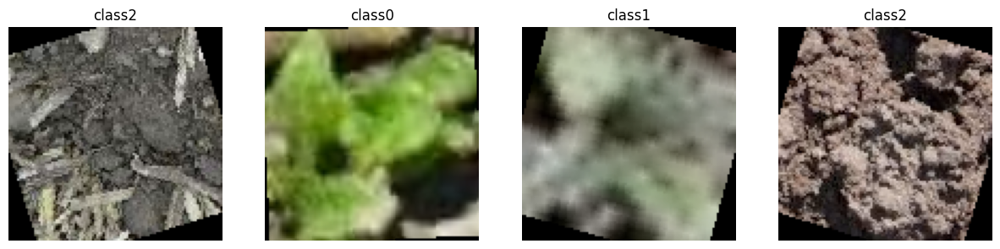

In [ ]:
trainimage_sample , trainlabel_sample = next(iter(train_dataloader))
trainimage_sample.shape , trainlabel_sample.shape
fig, axis = plt.subplots(1, 4, figsize=(15, 10))
for i, ax in enumerate(axis.flat):
    with torch.no_grad():
        img = trainimage_sample[i].numpy()
        img = np.transpose(img, (1, 2, 0))
        ax.imshow(img)
        ax.set(title = f"{getlabel(trainlabel_sample[i])}")
        ax.axis('off')

In [ ]:
print(f"the size of the test dataloader {len(test_dataloader)} batches of {BATCH_SIZE}")

the size of the test dataloader 5500 batches of 4


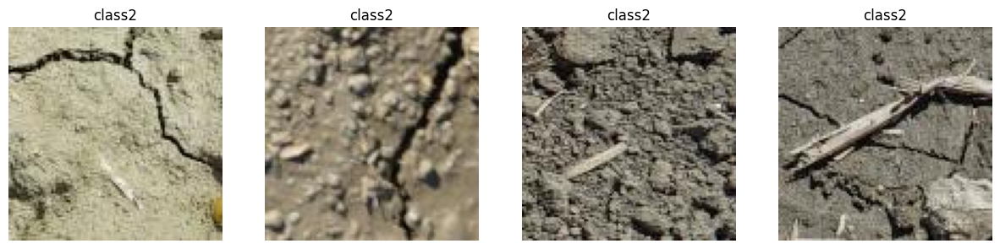

In [ ]:
testimage_sample , testlabel_sample = next(iter(test_dataloader))
testimage_sample.shape , testlabel_sample.shape
fig, axis = plt.subplots(1, 4, figsize=(15, 10))
for i, ax in enumerate(axis.flat):
    with torch.no_grad():
        img = testimage_sample[i].numpy()
        img = np.transpose(img, (1, 2, 0))
        ax.imshow(img)
        ax.set(title = f"{getlabel(testlabel_sample[i])}")
        ax.axis('off')

## Model


In [ ]:
def param_count(model):
    params = [p.numel() for p in model.parameters() if p.requires_grad]
    print('Total number of parameters : ', sum(params))

### Define architecture

In [ ]:
class CNN(nn.Module) :
    def __init__(self, input_shape , output) :
        super().__init__()
        self.block1 = nn.Sequential(
            nn.Conv2d(
                in_channels = input_shape ,
                out_channels = 32 ,
                kernel_size = (3,3) ,
                padding = 1 ,
                stride = 2
            ) ,

            nn.ReLU() ,

            nn.Conv2d(
                in_channels = 32 ,
                out_channels = 64 ,
                kernel_size = (3,3) ,
                padding = 1 ,
                stride = 2
            ) ,

            nn.ReLU() ,

            nn.MaxPool2d(kernel_size = 2)
        )

        self.block2 = nn.Sequential(
            nn.Conv2d(
                in_channels = 64 ,
                out_channels = 128 ,
                kernel_size = (3,3) ,
                padding = 1 ,
                stride = 2
            ) ,

            nn.ReLU() ,

            nn.Conv2d(
                in_channels = 128 ,
                out_channels = 256 ,
                kernel_size = (3,3) ,
                padding = 1 ,
                stride = 2
            ) ,

            nn.ReLU() ,

            nn.MaxPool2d(kernel_size = 2)
        )

        self.fc = nn.Sequential(
            nn.Flatten() ,

            nn.Linear(in_features=256*1*1
                      , out_features=output)
        )



    def forward(self , x ) :
        x = self.block1(x)
#         print(f"The shape of the first conv block is {x.shape}")
        x = self.block2(x)
#         print(f"The shape of the second conv block is {x.shape}")
        x = self.fc(x)

        return x


In [ ]:
from torchsummary import summary

torch.manual_seed(42)
model=CNN(
    input_shape = 3 ,
    output=len(classes)
)

summary(model, (3, img_size, img_size))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 50, 50]             896
              ReLU-2           [-1, 32, 50, 50]               0
            Conv2d-3           [-1, 64, 25, 25]          18,496
              ReLU-4           [-1, 64, 25, 25]               0
         MaxPool2d-5           [-1, 64, 12, 12]               0
            Conv2d-6            [-1, 128, 6, 6]          73,856
              ReLU-7            [-1, 128, 6, 6]               0
            Conv2d-8            [-1, 256, 3, 3]         295,168
              ReLU-9            [-1, 256, 3, 3]               0
        MaxPool2d-10            [-1, 256, 1, 1]               0
          Flatten-11                  [-1, 256]               0
           Linear-12                    [-1, 3]             771
Total params: 389,187
Trainable params: 389,187
Non-trainable params: 0
-------------------------------

In [ ]:
model.parameters

<bound method Module.parameters of CNN(
  (block1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (block2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (fc): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=256, out_features=3, bias=True)
  )
)>

In [ ]:
param_count(model)

Total number of parameters :  389187


### Training

In [ ]:
criterion=nn.CrossEntropyLoss()
optimizer=Adam(model.parameters(),lr=0.001)

In [ ]:
epochs = 5
training_loss = []
training_acc = []

for i in tqdm(range(epochs)) :
    epoch_loss = 0
    epoch_acc = 0

    for batch , (x_train , y_train) in enumerate(train_dataloader) :
        y_pred = model.forward(x_train)

        loss = criterion(y_pred , y_train)

        if batch % 100 == 0:
            print(f"Looked at {batch * len(x_train)}/{len(train_dataloader.dataset)} samples.")

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

        epoch_loss +=loss
        epoch_acc += accuracy_score(y_train , y_pred.argmax(dim=1))


    training_loss.append((epoch_loss/len(train_dataloader)).detach().numpy())
    training_acc.append(epoch_acc/len(train_dataloader))

    print(f"Epoch {i}: Accuracy: {(epoch_acc/len(train_dataloader)) * 100}, Loss: {(epoch_loss/len(train_dataloader))}\n\n")

In [ ]:
print(f"The accuracy of the training set is : {(training_acc[-1] * 100):0.2f}%")
print(f"The loss of the training set is : {training_loss[-1]}")

The accuracy of the training set is : 85.33%
The loss of the training set is : 0.35933953523635864


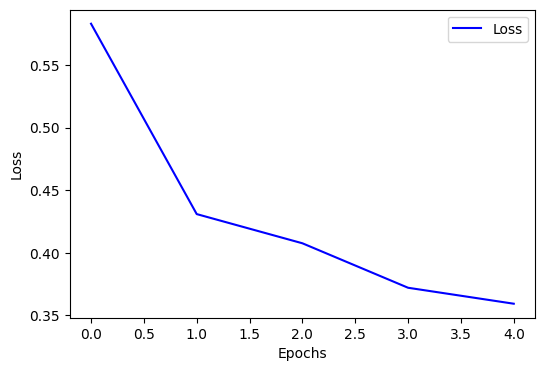

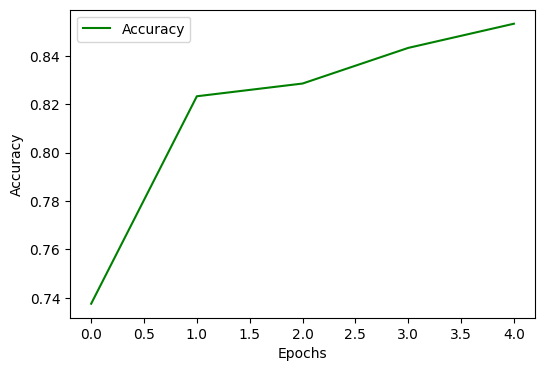

In [ ]:
plt.subplots(figsize=(6,4))
plt.plot(range(epochs),training_loss,color="blue",label="Loss")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.subplots(figsize=(6,4))
plt.plot(range(epochs),training_acc,color="green",label="Accuracy")
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
torch.save(model.state_dict(), '/data/pesi.pth')

### Test

In [ ]:
test_loss=0
test_acc= 0
test_preds=[]
x_test_samples=[]
test_targets = []
torch.manual_seed(42)

with torch.no_grad() :
        for x_test , y_test in test_dataloader :
            y_pred=model.forward(x_test)
            test_pred = torch.softmax(y_pred , dim=1 ).argmax(dim=1)
            test_preds.append(test_pred)
            test_targets.extend(y_test)
            x_test_samples.append(x_test)
            loss=criterion(y_pred,y_test)
            test_loss+=loss
            test_acc += accuracy_score(y_test , y_pred.argmax(dim=1))


test_loss/=len(test_dataloader)
test_acc/=len(test_dataloader)
test_preds = torch.cat(test_preds)
test_targets = torch.Tensor(test_targets)
x_test_samples=np.array(x_test_samples)

In [ ]:
print(f"The loss of the testing set is : {test_loss}\n")
print(f"The accuracy of the testing set is : {(test_acc*100):0.2f}%\n")

The loss of the testing set is : 0.6889938116073608

The accuracy of the testing set is : 86.63%



In [ ]:
fig, axis = plt.subplots(1, 4, figsize=(35, 20))
for i, ax in enumerate(axis.flat):
    with torch.no_grad():
        img = x_test_samples[0][i].numpy()
        img = np.transpose(img, (1, 2, 0))
        ax.imshow(img)
        ax.set(title = f"Predicted : {getlabel(test_preds[i])} , True : {getlabel(test_targets[i])}")
        ax.axis('off')

In [ ]:
print(f"The accuracy of the training set is : {(training_acc[-1] * 100):0.2f}%")
print(f"The accuracy of the testing set is : {(test_acc*100):0.2f}%\n")
print(f"\nRecall : {recall_score(test_targets,test_preds,average='weighted')}")
print(f"\nPrecision : {precision_score(test_targets,test_preds,average='weighted')}")
print(f"\nF1 Score {f1_score(test_targets,test_preds,average='weighted')}\n")

The accuracy of the training set is : 85.33%
The accuracy of the testing set is : 86.63%


Recall : 0.8662727272727273

Precision : 0.8363928166780062

F1 Score 0.8419225437102222



In [ ]:
#!pip install torchmetrics

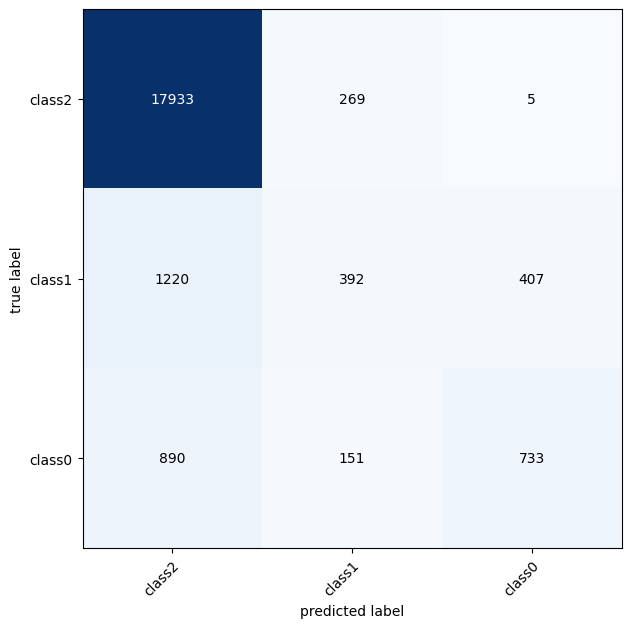

In [ ]:
from torchmetrics import ConfusionMatrix

confmat = ConfusionMatrix(num_classes=len(classes), task='multiclass')
confmat_tensor = confmat(preds=test_preds,
                         target=test_targets)

fig, ax = plot_confusion_matrix(
    conf_mat=confmat_tensor.numpy(),
    class_names=classes,
    figsize=(10, 7)
)

In [ ]:
def ricostruisci_immagine(input_path,dimensione_blocco = 100):

  # Apri l'immagine
  immagine = Image.open(input_path)

  L = test_dataloader.dataset.test_path

  # Ottieni le dimensioni dell'immagine
  larghezza, altezza = immagine.size
  ans = []
  for y in range(0, altezza, dimensione_blocco):
        for x in range(0, larghezza, dimensione_blocco):
            d = ""
            box = (x, y, x + dimensione_blocco, y + dimensione_blocco)
            blocco = immagine.crop(box)

            # Crea un nome univoco per il blocco
            nome_blocco = os.path.splitext(os.path.basename(input_path))[0]+f"_block_{y//dimensione_blocco}_{x//dimensione_blocco}.jpg"

            for i in range (0,3):
              nome = f"/data/testing_images/class{i}/" + nome_blocco

              if nome in L:
                ans.append(L.index(nome))
                break

  return ans


In [ ]:
def test_image():
  for i in range(1):

    random_number = random.randint(0, 20)
    input_path = images_folder + "/" + lines[random_number][:-1]+".jpg"

    ans = ricostruisci_immagine(input_path)

    matrix = []

    L = test_dataloader.dataset.test_path

    L_preds = []
    for i in test_preds:
      if i == 0:
        L_preds.append(0)
      elif i == 1:
        L_preds.append(1)
      else:
        L_preds.append(2)

    for i in ans:
      matrix.append(L_preds[i])


    # Inizializza le matrici con zeri
    matrice_label0 = np.zeros((1088 // dimensione_box + 1, 1920 // dimensione_box + 1), dtype=int)
    matrice_label1 = np.zeros((1088 // dimensione_box + 1, 1920 // dimensione_box + 1), dtype=int)

    i = 0

    for x in range(1088 // dimensione_box + 1):
      for y in range(1920 // dimensione_box + 1):
        if matrix[i] == 1:
          matrice_label1[x][y] = 1
        i += 1

    i = 0

    for x in range(1088 // dimensione_box + 1):
      for y in range(1920 // dimensione_box + 1):
        if matrix[i] == 2:
          matrice_label0[x][y] = 1
        i += 1


    df_predict = create_bbbox_from_matrix([matrice_label0,matrice_label1],dimensione_box)
    visualizza_immagine_con_bbox2(input_path, df_predict)

    csv_path = label_folder + "/" + lines[random_number][:-1]+".csv"
    visualizza_immagine_con_bbox(input_path, csv_path)


    df_real = pd.read_csv(csv_path, names=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

    return [df_predict,df_real]





In [ ]:
def intersection_over_union(box_a, box_b):
    # Estrai le coordinate dei box A
    left_a, top_a, right_a, bottom_a = (
        box_a["Left"], box_a["Top"], box_a["Right"], box_a["Bottom"]
    )

    # Estrai le coordinate dei box B
    left_b, top_b, right_b, bottom_b = (
        box_b["Left"], box_b["Top"], box_b["Right"], box_b["Bottom"]
    )

    # Calcola l'area dell'intersezione
    x_left = max(left_a, left_b)
    y_top = max(top_a, top_b)
    x_right = min(right_a, right_b)
    y_bottom = min(bottom_a, bottom_b)

    intersection_area = max(0, x_right - x_left + 1) * max(0, y_bottom - y_top + 1)

    # Calcola l'area dell'unione
    area_a = (right_a - left_a + 1) * (bottom_a - top_a + 1)
    area_b = (right_b - left_b + 1) * (bottom_b - top_b + 1)
    union_area = area_a + area_b - intersection_area

    # Calcola IoU
    iou = intersection_area / union_area
    #print(iou)
    return iou

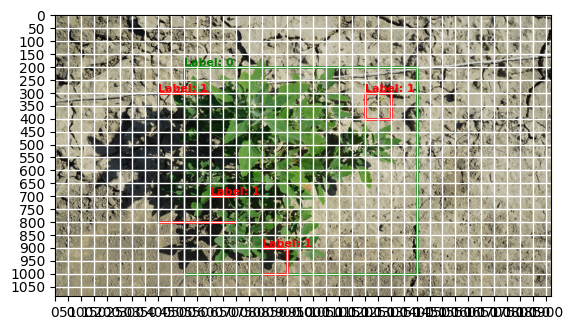

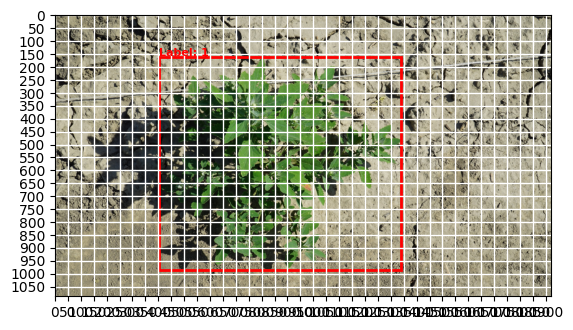

0.12763621409394932


In [ ]:
with open('/data/test_split.txt') as f:
    lines = f.readlines()

[df_predict,df_real] = test_image()

acc = 0
for _, box_a in df_real.iterrows():
  iou = 0
  for _, box_b in df_predict.iterrows():
    if box_a["Label"] == box_b["Label"]:
      iou = max(intersection_over_union(box_a, box_b), iou)
  acc += iou

print(acc/len(df_real))


# CNN Approach using image classification with localisation and Sliding window


## Setup

This script utilizes several Python libraries for image processing and object detection.

- `warnings`: Python module to handle warning messages.
- `cv2`: OpenCV library for computer vision tasks.
- `os`: Operating system interaction, used for file operations.
- `re`: Regular expression library for string matching.
- `torch` and `torchvision`: PyTorch and its vision library for deep learning tasks.
- `transforms`: Module from torchvision for image transformations.
- `FastRCNNPredictor`, `FasterRCNN`, `AnchorGenerator`: Components from torchvision for Faster R-CNN model.
- `DataLoader`, `Dataset`, `SequentialSampler`: PyTorch utilities for handling datasets and data loading.
- `pyplot` from `matplotlib`: Plotting library for visualization.

Additionally, there are redundant import statements, such as importing `shutil`, `os`, and `plt` again after their initial import.


In [97]:
import warnings
warnings.filterwarnings('ignore')

import cv2
import os
import re
import torch
import torchvision
from torchvision import transforms
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torch.utils.data import DataLoader, Dataset
from torch.utils.data.sampler import SequentialSampler
from matplotlib import pyplot as plt

import shutil

import matplotlib.patches as patches
import pandas as pd
from PIL import Image

import numpy as np
import random


This section reads the training data from a text file named 'train_split.txt'.

- `open('data/train_split.txt')`: Opens the file 'train_split.txt' located in the 'data' directory.
- `f.readlines()`: Reads all lines from the file and stores them in the variable `train_list`.


In [98]:
with open('data/train_split.txt') as f:
    train_list = f.readlines()

This code determines and sets the device for training based on the availability of CUDA (GPU).

- `torch.device('cuda' if torch.cuda.is_available() else 'cpu')`: Checks if a GPU (CUDA) is available; if true, sets the device to CUDA, otherwise to CPU.
- `device`: Holds the selected device (CUDA or CPU) for training.

In [99]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cpu')

### Support functions

#### Create Matrix from Bounding Boxes

This function reads a CSV file containing bounding box information and creates a matrix based on the specified labels.

- `csv_path`: Path to the CSV file containing bounding box information.

The function performs the following steps:

1. Reads the CSV file into a DataFrame (`df`) with columns: "Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY".
2. Initializes a matrix (`matrice_label`) with zeros of shape (1920, 1088) and dtype=int.

3. Iterates over the rows of the DataFrame:
   - Extracts bounding box coordinates.
   - Calculates the matrix indices corresponding to the bounding box.
   - Sets matrix elements based on the label:
     - If the label is 0, sets the corresponding elements to 1.
     - If the label is 1, sets the corresponding elements to 2.

4. Returns the resulting matrix.

In [100]:
import pandas as pd
import numpy as np

def crea_matrice_da_bbox(csv_path):
    # Read the CSV file containing bounding boxes
    df = pd.read_csv(csv_path, names=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

    # Initialize matrices with zeros
    matrice_label = np.zeros((1920, 1088), dtype=int)

    # Iterate over DataFrame rows
    for index, row in df.iterrows():
        # Get bounding box coordinates
        left, top, right, bottom = row['Left'], row['Top'], row['Right'], row['Bottom']

        # Calculate matrix indices for the bounding box
        col_start_index, col_end_index = left, right
        row_start_index, row_end_index = top, bottom

        # Set matrix elements based on the label
        for i in range(col_start_index, col_end_index):
            for j in range(row_start_index, row_end_index):
                if row['Label'] == 0:
                    matrice_label[i, j] = 1
                if row['Label'] == 1:
                    matrice_label[i, j] = 2

    return matrice_label

#### Get Box Label

This function extracts a sub-matrix (box) from a given matrix based on specified coordinates.

- `matrix`: The input matrix from which to extract the sub-matrix.
- `x`: The starting x-coordinate of the sub-matrix.
- `y`: The starting y-coordinate of the sub-matrix.

The function performs the following steps:

1. Extracts a sub-matrix (box) of size 256x256 from the input matrix.
2. Returns the extracted sub-matrix.

In [101]:
def get_box_label(matrix, x, y):

  """
    Extract a sub-matrix (box) from the given matrix based on specified coordinates.

    Parameters:
    - matrix: The input matrix from which to extract the sub-matrix.
    - x: The starting x-coordinate of the sub-matrix.
    - y: The starting y-coordinate of the sub-matrix.

    Returns:
    - box: The extracted sub-matrix of size 256x256.
    """

  box = matrix[x:x+256 ,y:y+256]
  return box


#### Find Region Bounds

This function finds the bounding box coordinates of a specified target value within a matrix.

- `matrix`: The input matrix to search for the target value.
- `target_value`: The value to be located in the matrix.

The function performs the following steps:

1. Uses `np.where` to find the indices where the target value is present in the matrix.
2. Raises a `ValueError` if the target value is not found in the matrix.
3. Calculates the minimum and maximum indices along each axis to determine the bounding box coordinates.
4. Returns the bounding box coordinates (xmin, ymin, xmax, ymax).

In [102]:
def find_region_bounds(matrix, target_value):
    """
    Find the bounding box coordinates of a specified target value within a matrix.

    Parameters:
    - matrix: The input matrix to search for the target value.
    - target_value: The value to be located in the matrix.

    Returns:
    - xmin, ymin, xmax, ymax: Bounding box coordinates of the target value.
    """
    indices = np.where(matrix == target_value)

    if len(indices[0]) == 0:
        raise ValueError(f"Value {target_value} not found in the matrix.")

    ymin, xmin = np.min(indices, axis=1)
    ymax, xmax = np.max(indices, axis=1)

    return xmin, ymin, xmax, ymax

This function calculates the intersection between two bounding boxes.

- `bbox1`: The coordinates of the first bounding box (xmin1, ymin1, xmax1, ymax1).
- `bbox2`: The coordinates of the second bounding box (xmin2, ymin2, xmax2, ymax2).

The function performs the following steps:

1. Calculates the left, top, right, and bottom coordinates of the intersection between the two bounding boxes.
2. Checks if there is a valid intersection by verifying that the left coordinate is less than the right and the top coordinate is less than the bottom.
3. Returns the coordinates of the intersection if it exists; otherwise, returns `None` to indicate no intersection.


#### Calculate Intersection

In [103]:
def calcola_intersezione(bbox1, bbox2):
    """
    Calculate the intersection between two bounding boxes.

    Parameters:
    - bbox1: Coordinates of the first bounding box (xmin1, ymin1, xmax1, ymax1).
    - bbox2: Coordinates of the second bounding box (xmin2, ymin2, xmax2, ymax2).

    Returns:
    - Coordinates of the intersection (left, top, right, bottom) if it exists, otherwise returns None.
    """
    left = max(bbox1[0], bbox2[0])
    top = max(bbox1[1], bbox2[1])
    right = min(bbox1[2], bbox2[2])
    bottom = min(bbox1[3], bbox2[3])

    # Check if there is a valid intersection
    if left < right and top < bottom:
        return left, top, right, bottom
    else:
        return None  # No intersection

#### Calculate Area

This function calculates the area of a bounding box.

- `box`: Coordinates of the bounding box (xmin, ymin, xmax, ymax).

The function performs the following steps:

1. Extracts the xmin, ymin, xmax, and ymax coordinates from the bounding box.
2. Calculates the area of the bounding box using the formula: `area = (xmax - xmin) * (ymax - ymin)`.
3. Returns the computed area.

In [104]:
def calcola_area(box):
    """
    Calculate the area of a bounding box.

    Parameters:
    - box: Coordinates of the bounding box (xmin, ymin, xmax, ymax).

    Returns:
    - area: The area of the bounding box.
    """
    xmin, ymin, xmax, ymax = box[0], box[1], box[2], box[3]
    area = (xmax - xmin) * (ymax - ymin)
    return area

#### Delete Folder

This function attempts to delete a folder and its contents.

- `folder_path`: The path of the folder to be deleted.

The function performs the following steps:

1. Uses `shutil.rmtree` to recursively remove the specified folder and its contents.
2. Prints a success message if the deletion is successful.
3. Prints an error message if an exception occurs during the deletion process.



In [105]:
import shutil
import os

def delete_folder(folder_path):
    """
    Delete a folder and its contents.

    Parameters:
    - folder_path: The path of the folder to be deleted.
    """
    try:
        shutil.rmtree(folder_path)
        print(f"Successfully deleted the folder: {folder_path}")
    except Exception as e:
        print(f"Error deleting the folder: {e}")

#### Convert Center to Coordinates

This function converts bounding box information from center coordinates and dimensions to corner coordinates.

- `centerX`: The x-coordinate of the center of the bounding box.
- `centerY`: The y-coordinate of the center of the bounding box.
- `width`: The width of the bounding box.
- `height`: The height of the bounding box.

The function performs the following steps:

1. Calculates the x1, y1, x2, and y2 coordinates of the bounding box corners using the provided center coordinates, width, and height.
2. Returns the computed corner coordinates.

In [106]:
def convert_center_to_coords(centerX, centerY, width, height):

    """
    Convert bounding box information from center coordinates and dimensions to corner coordinates.

    Parameters:
    - centerX: The x-coordinate of the center of the bounding box.
    - centerY: The y-coordinate of the center of the bounding box.
    - width: The width of the bounding box.
    - height: The height of the bounding box.

    Returns:
    - x1, y1, x2, y2: Coordinates of the bounding box corners.
    """

    x1 = int(centerX - width / 2)
    y1 = int(centerY - height / 2)
    x2 = int(centerX + width / 2)
    y2 = int(centerY + height / 2)
    return x1, y1, x2, y2

##### Convert Coordinates to Center

This function converts bounding box corner coordinates to center coordinates and dimensions.

- `x1, y1`: Coordinates of the top-left corner of the bounding box.
- `x2, y2`: Coordinates of the bottom-right corner of the bounding box.

The function performs the following steps:

1. Calculates the centerX and centerY coordinates as the midpoint between x1 and x2, y1 and y2, respectively.
2. Calculates the width and height of the bounding box.
3. Returns the computed centerX, centerY, width, and height.

In [107]:
def convert_coords_to_center(x1, y1, x2, y2):
    centerX = (x1 + x2) / 2
    centerY = (y1 + y2) / 2
    width = x2 - x1
    height = y2 - y1
    return centerX, centerY, width, height

## Create Dataset

#### Process Images and Bounding Boxes

This script processes images and bounding boxes, creating smaller image blocks and corresponding metadata.

- `delete_folder('data/immagini_piccole/')`: Deletes the folder 'immagini_piccole' and its contents.
- `df_train_all`: List to store metadata for each processed image block.
- `output_directory`: Path to the folder where smaller image blocks will be saved.
- `dimensione_blocco`: Size of the image blocks (256x256 pixels).
- `total_image_number`: Total number of images to process.

The script iterates over each image, loads its corresponding bounding box CSV, and creates smaller image blocks. Metadata for each block, including presence, label, and bounding box information, is stored in `df_train_all`.


In [108]:
from PIL import Image
import os
import operator


delete_folder('data/immagini_piccole/')
df_train_all = []
output_directory = "data/immagini_piccole/"
dimensione_blocco=256
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

total_image_number = len(train_list) - 1
#total_image_number = 10

counter = 0

for num_img in range(total_image_number):

  print(f"Loading image number {num_img} / {total_image_number}")

  input_path = "data/images/" + train_list[num_img][:-1] + ".jpg"

  csv_path = "data/bboxes/CropOrWeed2/" + train_list[num_img][:-1] + ".csv"

  immagine = Image.open(input_path)

  # Ottieni le dimensioni dell'immagine
  larghezza, altezza = immagine.size

  df_image = pd.read_csv(csv_path, names=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

  df_image["centerX"] = (df_image["Right"] - df_image["Left"] ) / 2 + df_image["Left"]
  df_image["centerY"] = (df_image["Bottom"] - df_image["Top"] ) / 2 + df_image["Top"]
  df_image["width"] = (df_image["Right"] - df_image["Left"])
  df_image["heigth"] = (df_image["Bottom"] - df_image["Top"])

  for y in range(0, altezza , dimensione_blocco // 2):
      for x in range(0, larghezza , dimensione_blocco // 2):
          intersezioni = []
          box = (x, y, x + dimensione_blocco, y + dimensione_blocco)
          blocco = immagine.crop(box)

          label = 2
          presence = 0


          for i,row in df_image.iterrows():

            centerX, centerY, width, heigth = row["centerX"], row["centerY"], row["width"], row["heigth"]

            if (centerX < (x + dimensione_blocco)) and (centerX > x) and (centerY < (y + dimensione_blocco)) and (centerY > y):
              label = row["Label"]
              centerX, centerY, width, heigth = centerX - x, centerY - y, width, heigth
              presence = 1
              break
            else:
              centerX, centerY, width, heigth = 0,0,0,0
          # salvo blocchetto immagine
          nome_blocco = os.path.splitext(os.path.basename(input_path))[0]+f"_block_{x // dimensione_blocco}_{y // dimensione_blocco}_{counter}.jpg"
          blocco.save(os.path.join(output_directory, nome_blocco))

          df_train_all.append([ os.path.splitext(os.path.basename(input_path))[0], nome_blocco,presence, label, centerX, centerY, width, heigth])
          counter += 1


df_train_all = pd.DataFrame(df_train_all, columns = ["original_image","name", "presence","Label","centerX", "centerY", "width", "heigth"])

Error deleting the folder: [WinError 3] Impossibile trovare il percorso specificato: 'data/immagini_piccole/'
Loading image number 0 / 6163
Loading image number 1 / 6163
Loading image number 2 / 6163
Loading image number 3 / 6163
Loading image number 4 / 6163
Loading image number 5 / 6163
Loading image number 6 / 6163
Loading image number 7 / 6163
Loading image number 8 / 6163
Loading image number 9 / 6163
Loading image number 10 / 6163
Loading image number 11 / 6163
Loading image number 12 / 6163
Loading image number 13 / 6163
Loading image number 14 / 6163
Loading image number 15 / 6163
Loading image number 16 / 6163
Loading image number 17 / 6163
Loading image number 18 / 6163
Loading image number 19 / 6163
Loading image number 20 / 6163
Loading image number 21 / 6163
Loading image number 22 / 6163
Loading image number 23 / 6163
Loading image number 24 / 6163
Loading image number 25 / 6163
Loading image number 26 / 6163
Loading image number 27 / 6163
Loading image number 28 / 6163
L

In [109]:
df_train = df_train_all[["name", "presence","Label","centerX", "centerY", "width", "heigth"]]
df_train.head()

,name,presence,Label,centerX,centerY,width,heigth
0,vwg-0088-0005_block_0_0_0.jpg,0,2.0,0.0,0.0,0.0,0.0
1,vwg-0088-0005_block_0_0_1.jpg,0,2.0,0.0,0.0,0.0,0.0
2,vwg-0088-0005_block_1_0_2.jpg,0,2.0,0.0,0.0,0.0,0.0
3,vwg-0088-0005_block_1_0_3.jpg,0,2.0,0.0,0.0,0.0,0.0
4,vwg-0088-0005_block_2_0_4.jpg,0,2.0,0.0,0.0,0.0,0.0


This script adds binary columns to the DataFrame `df_train` based on the 'Label' column.

- `df_train['type0']`: Binary column indicating if 'Label' is equal to 0 (1 if true, 0 otherwise).
- `df_train['type1']`: Binary column indicating if 'Label' is equal to 1 (1 if true, 0 otherwise).


In [110]:
df_train['type0'] = (df_train['Label'] == 0).astype(int)
df_train['type1'] = (df_train['Label'] == 1).astype(int)

In [111]:
# Drop the 'Label' column from the DataFrame
df_train = df_train.drop(columns=['Label'])

In [112]:
# Display the head of the DataFrame
df_train.head(-10)

,name,presence,centerX,centerY,width,heigth,type0,type1
0,vwg-0088-0005_block_0_0_0.jpg,0,0.0,0.0,0.0,0.0,0,0
1,vwg-0088-0005_block_0_0_1.jpg,0,0.0,0.0,0.0,0.0,0,0
2,vwg-0088-0005_block_1_0_2.jpg,0,0.0,0.0,0.0,0.0,0,0
3,vwg-0088-0005_block_1_0_3.jpg,0,0.0,0.0,0.0,0.0,0,0
4,vwg-0088-0005_block_2_0_4.jpg,0,0.0,0.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...
831990,vwg-0030-0012_block_0_4_831990.jpg,0,0.0,0.0,0.0,0.0,0,0
831991,vwg-0030-0012_block_0_4_831991.jpg,0,0.0,0.0,0.0,0.0,0,0
831992,vwg-0030-0012_block_1_4_831992.jpg,0,0.0,0.0,0.0,0.0,0,0
831993,vwg-0030-0012_block_1_4_831993.jpg,0,0.0,0.0,0.0,0.0,0,0


In [113]:
# Count occurrences of each 'name' in DataFrame
df_train["name"].value_counts()

vwg-0088-0005_block_0_0_0.jpg         1
vwg-0777-0014_block_2_3_554674.jpg    1
vwg-0777-0014_block_4_2_554664.jpg    1
vwg-0777-0014_block_5_2_554665.jpg    1
vwg-0777-0014_block_5_2_554666.jpg    1
                                     ..
vwg-1306-0013_block_1_1_277338.jpg    1
vwg-1306-0013_block_2_1_277339.jpg    1
vwg-1306-0013_block_2_1_277340.jpg    1
vwg-1306-0013_block_3_1_277341.jpg    1
vwg-0030-0012_block_7_4_832004.jpg    1
Name: name, Length: 832005, dtype: int64

In [114]:
num_to_labels = {0:'type0',1:'type1',2:"dirt"}

This script prints the counts of occurrences for the binary columns 'type0' and 'type1', as well as the count of 'Dirt' presence in the DataFrame `df_train`.

Notice that the DataFrame is unbalanced.

In [115]:
print("type0: ",(df_train["type0"]==1).sum())
print("type1: ",(df_train["type1"]==1).sum())
print("Dirt: ",(df_train["presence"]==0).sum())

type0:  47271
type1:  107478
Dirt:  677256


#### Data Argumentation

This script performs image augmentation by applying various transformations to selected images with label 'type0'.

- `number_images_to_argument`: The number of augmented images to generate.
- `list_paths`: List of paths for images with label 'type0'.
- `random_elements`: Randomly selected paths from `list_paths` for augmentation.
- `ia.seed(1)`: Sets the random seed for reproducibility.

The script iterates over randomly selected images, applies a sequence of augmentations using `imgaug`, and saves the augmented images with updated metadata in the DataFrame `df_train`.


In [116]:
import imgaug as ia
import imgaug.augmenters as iaa
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage

number_images_to_argument = (df_train["type0"]==1).sum()

list_paths = df_train[df_train["type0"]==1]["name"].tolist()

random_elements = random.choices(list_paths, k=int(number_images_to_argument))

i = 0
ia.seed(1)

for name in random_elements:
    print(i + 1, "/", len(random_elements))

    path = 'data/immagini_piccole/' + name

    centerX, centerY, width, height = df_train[df_train["name"] == name]["centerX"], df_train[
        df_train["name"] == name]["centerY"], df_train[df_train["name"] == name]["width"], df_train[
        df_train["name"] == name]["heigth"]
    x1, y1, x2, y2 = convert_center_to_coords(centerX, centerY, width, height)

    image = cv2.imread(path)
    bbs = BoundingBoxesOnImage([
        BoundingBox(x1, y1, x2, y2),
    ], shape=image.shape)

    # Define the sequence of transformations
    seq = iaa.Sequential([
        iaa.Affine(rotate=(-20, 20)),  # Random rotation between -45 and 45 degrees
        iaa.Fliplr(0.5),  # Horizontal flip with a 50% probability
        iaa.Flipud(0.5),  # Vertical flip with a 50% probability
        iaa.GaussianBlur(sigma=(0, 1.0)),  # Apply Gaussian blur with random variance between 0 and 1.0
        iaa.ContrastNormalization((0.5, 1.5)),  # Modify image brightness
    ])

    # Augment BBs and images.
    img_aug, bbs_aug = seq(image=image, bounding_boxes=bbs)

    new_x1, new_y1, new_x2, new_y2 = bbs_aug[0].x1, bbs_aug[0].y1, bbs_aug[0].x2, bbs_aug[0].y2
    new_centerX, new_centerY, new_width, new_height = convert_coords_to_center(new_x1, new_y1, new_x2, new_y2)

    df_train = df_train.append(
        {'name': name[:-4] + "_" + str(i) + '.jpg', 'presence': df_train[df_train["name"] == name]["presence"].item(),
         'centerX': new_centerX, 'centerY': new_centerY, 'width': new_width, 'heigth': new_height,
         'type0': df_train[df_train["name"] == name]["type0"].item(),
         'type1': df_train[df_train["name"] == name]["type1"].item()}, ignore_index=True)

    # Save the augmented image with the new name
    new_path = os.path.join('data/immagini_piccole/', name[:-4] + "_" + str(i) + '.jpg')
    cv2.imwrite(new_path, img_aug)

    i += 1


1 / 47271
2 / 47271
3 / 47271
4 / 47271
5 / 47271
6 / 47271
7 / 47271
8 / 47271
9 / 47271
10 / 47271
11 / 47271
12 / 47271
13 / 47271
14 / 47271
15 / 47271
16 / 47271
17 / 47271
18 / 47271
19 / 47271
20 / 47271
21 / 47271
22 / 47271
23 / 47271
24 / 47271
25 / 47271
26 / 47271
27 / 47271
28 / 47271
29 / 47271
30 / 47271
31 / 47271
32 / 47271
33 / 47271
34 / 47271
35 / 47271
36 / 47271
37 / 47271
38 / 47271
39 / 47271
40 / 47271
41 / 47271
42 / 47271
43 / 47271
44 / 47271
45 / 47271
46 / 47271
47 / 47271
48 / 47271
49 / 47271
50 / 47271
51 / 47271
52 / 47271
53 / 47271
54 / 47271
55 / 47271
56 / 47271
57 / 47271
58 / 47271
59 / 47271
60 / 47271
61 / 47271
62 / 47271
63 / 47271
64 / 47271
65 / 47271
66 / 47271
67 / 47271
68 / 47271
69 / 47271
70 / 47271
71 / 47271
72 / 47271
73 / 47271
74 / 47271
75 / 47271
76 / 47271
77 / 47271
78 / 47271
79 / 47271
80 / 47271
81 / 47271
82 / 47271
83 / 47271
84 / 47271
85 / 47271
86 / 47271
87 / 47271
88 / 47271
89 / 47271
90 / 47271
91 / 47271
92 / 472

In [117]:
print("type0: ",(df_train["type0"]==1).sum())
print("type1: ",(df_train["type1"]==1).sum())
print("Dirt: ",(df_train["presence"]==0).sum())

type0:  94542
type1:  107478
Dirt:  677256


##### Balance Data Labels

This script balances the data labels in the DataFrame `df_train` by randomly selecting rows with label 'presence' equal to 0 to match the count of rows with label 'type0'.

- `count_0`: Number of examples with label 'type0'.
- `count_dirt`: Number of examples with label 'presence' equal to 0.
- `rows_to_drop`: Randomly selected rows with label 'presence' equal to 0 to achieve a balance.
- `df`: DataFrame with balanced data labels.



In [118]:
# Find the number of examples for each label
count_0 = (df_train["type0"] == 1).sum()
count_dirt = (df_train["presence"] == 0).sum()

# Randomly select rows with label 'presence' equal to 0 to match the count of rows with label 'type0'
rows_to_drop = df_train[df_train['presence'] == 0].sample(n=count_dirt - count_0, random_state=42).index
df = df_train.drop(rows_to_drop)

df_train = df

In [119]:
print("type0: ",(df_train["type0"]==1).sum())
print("type1: ",(df_train["type1"]==1).sum())
print("Dirt: ",(df_train["presence"]==0).sum())

type0:  94542
type1:  107478
Dirt:  94542


Notice now that the Dataframe is balaced due the previous data argumentations and the frop of examples of 'dirt'

In [120]:
# Reset the index of the DataFrame
df_train = df_train.reset_index(drop=True)

#### Split Data for Training and Validation

This script splits the DataFrame `df_train` into training and validation sets.

- `num_samples`: Total number of samples in the DataFrame.
- `validation_split`: Percentage of data to allocate for validation (in this case, 20%).
- `num_validation_samples`: Number of samples to use for validation.
- `random_indices`: Randomly permuted indices of the samples.
- `validation_indices`: Indices reserved for validation.
- `training_indices`: Indices remaining for training.

In [121]:
# Calculate the total number of samples
num_samples = len(df_train)

# Define the percentage of data to allocate for validation
validation_split = 0.2

# Calculate the number of samples to use for validation
num_validation_samples = int(validation_split * num_samples)

# Generate randomly permuted indices of the samples
random_indices = np.random.permutation(num_samples)

# Separate indices for validation and training
validation_indices = random_indices[:num_validation_samples]
training_indices = random_indices[num_validation_samples:]

This script creates separate DataFrames for training and validation using the indices obtained from the data split.

- `df_training`: DataFrame for training data.
- `df_validation`: DataFrame for validation data.

In [122]:
df_training = df_train.loc[training_indices.tolist()].reset_index(drop=True)
df_validation = df_train.loc[validation_indices.tolist()].reset_index(drop=True)

#### Create Train set

This script defines a custom PyTorch `Dataset` class for training data.

- `train_data` class:
  - `__init__`: Initializes the dataset with paths, labels, presence information, and bounding boxes.
  - `__len__`: Returns the total number of samples in the dataset.
  - `__getitem__`: Loads and preprocesses an image along with its presence, label, and bounding box information.


In [123]:
class train_data(Dataset):
    def __init__(self, train_path, train_label, train_presence, train_box):
        self.train_path = train_path
        self.train_label = train_label
        self.train_presence = train_presence
        self.train_box = train_box

    def __len__(self):
        return len(self.train_path)

    def __getitem__(self, index):
        img = cv2.imread(os.path.join("data/immagini_piccole", self.train_path.iloc[index]))

        # Resize all images to a fixed size
        image = cv2.resize(img, (256, 256))

        # Define the alpha and beta for contrast and brightness adjustments
        alpha = random.randint(1, 3)  # Contrast control [1-3]
        beta = random.uniform(0, 100)  # Brightness control [0-100]

        # Apply contrast and brightness adjustments
        adjusted_image = cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

        # Generate random Gaussian noise
        mean = 0
        stddev = 40
        noise = np.zeros(img.shape, np.uint8)
        cv2.randn(noise, mean, stddev)

        # Add noise to the image
        adjusted_image = cv2.add(img, noise)

        # Normalize the image by dividing it by 255.0
        adjusted_image = np.array(adjusted_image.astype("float") / 255.0)

        # Transpose the image to match PyTorch tensor format (C, H, W)
        adjusted_image = np.transpose(adjusted_image, (2, 0, 1))

        # Convert the image to a PyTorch tensor
        image = torch.from_numpy(adjusted_image).float()

        # Convert presence information to PyTorch tensor
        presence = np.array([self.train_presence.iloc[index]])
        presence = torch.from_numpy(presence).float()

        # Convert label information to PyTorch tensor
        arr = [float(self.train_label.iloc[index][0]), float(self.train_label.iloc[index][1])]
        label = np.array(arr)
        label = torch.from_numpy(label).float()

        # Convert bounding box information to PyTorch tensor
        arr = [
            float(self.train_box.iloc[index]["centerX"]) / 256,
            float(self.train_box.iloc[index]["centerY"]) / 256,
            float(self.train_box.iloc[index]["width"]) / 256,
            float(self.train_box.iloc[index]["heigth"]) / 256
        ]
        boxes = np.array(arr)
        boxes = torch.from_numpy(boxes).float()

        return image, presence, label, boxes


This script creates an instance of the custom `train_data` dataset class for training using the provided training data.

- `train_set`: Instance of the `train_data` dataset class for training.

In [124]:
train_set = train_data(df_training["name"] , df_training[["type0","type1"]] , df_training["presence"], df_training[["centerX", "centerY", "width", "heigth"]])

This script prints information about the training dataset and retrieves the shapes of sample data.


In [125]:
# Print the number of images in the training set
print(f"The number of images in the train set is: {train_set.__len__()}")

# Retrieve the shapes of sample data
filer_train_image = train_set.__getitem__(0)
filer_train_image[0].shape, filer_train_image[1].shape, filer_train_image[2].shape, filer_train_image[3].shape

The number of images in the train set is: 237250


(torch.Size([3, 256, 256]), torch.Size([1]), torch.Size([2]), torch.Size([4]))

In [126]:
BATCH_SIZE = 32


This script creates a PyTorch `DataLoader` for the training dataset.

- `torch.manual_seed(42)`: Sets the random seed for reproducibility.
- `train_dataloader`: DataLoader for the training dataset with specified batch size and shuffle.


In [127]:
# Set the random seed for reproducibility
torch.manual_seed(42)

# Create a DataLoader for the training dataset
train_dataloader = DataLoader(
    dataset=train_set,
    batch_size=BATCH_SIZE,
    shuffle=True
)

In [128]:
image_sample ,presence_sample,  label_sample, boxes_sample = next(iter(train_dataloader))
image_sample.shape,presence_sample.shape, label_sample.shape, boxes_sample.shape

(torch.Size([32, 3, 256, 256]),
 torch.Size([32, 1]),
 torch.Size([32, 2]),
 torch.Size([32, 4]))

In [129]:
def convert_to_corners(box):
    """
    Converte un box ["centerX", "centerY", "width", "height"] in ["Left", "Top", "Right", "Bottom"].
    """
    centerX, centerY, width, height = box

    left = centerX - width / 2
    top = centerY - height / 2
    right = centerX + width / 2
    bottom = centerY + height / 2

    return [left, top, right, bottom]


This script visualizes a sample of data from the training dataloader.

- `image_sample`: Sampled images from the dataloader.
- `presence_sample`: Presence information for each sample.
- `label_sample`: Label information for each sample.
- `boxes_sample`: Bounding box coordinates for each sample.

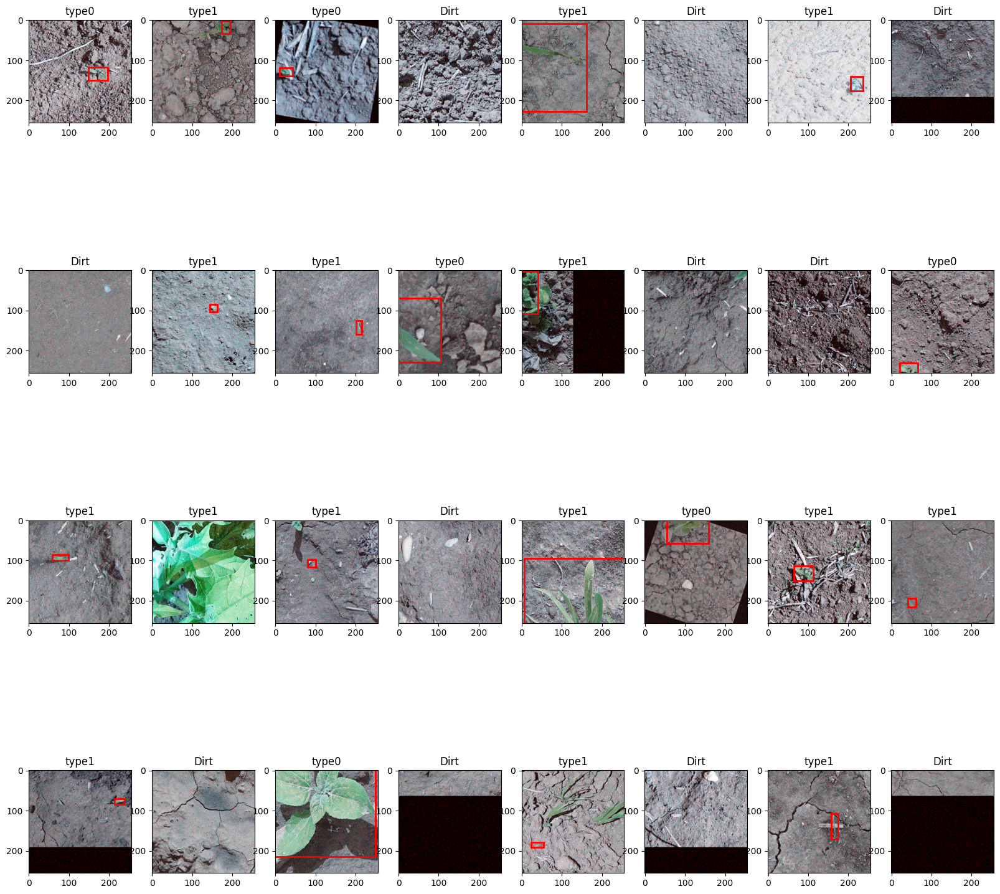

In [130]:
# Sample data from the dataloader
image_sample, presence_sample, label_sample, boxes_sample = next(iter(train_dataloader))

# Create a grid of subplots
fig, axs = plt.subplots(4, 8, figsize=(20, 20))

# Iterate over images and box coordinates
for i, (img, box) in enumerate(zip(image_sample, boxes_sample)):
    # Get the corresponding axis
    ax = axs[i // 8, i % 8]

    img = np.transpose(img, (1, 2, 0))

    # Display the image
    ax.imshow(img)

    if presence_sample[i] == 0:
        ax.set(title="Dirt")
    else:
        ax.set(title=f"{num_to_labels[label_sample[i][1].item()]}")

    # Add a rectangle to the plot with box coordinates
    box_coordinates = convert_to_corners(box)

    rect = patches.Rectangle((box_coordinates[0].item() * 256, box_coordinates[1].item() * 256),
                             256 * (box_coordinates[2].item() - box_coordinates[0].item()),
                             256 * (box_coordinates[3].item() - box_coordinates[1].item()),
                             linewidth=2, edgecolor='r', facecolor='none')

    # Add the rectangle to the axis
    ax.add_patch(rect)

# Show the plot
plt.show()

#### Create Validation set


This script defines a custom PyTorch `Dataset` class for validation data.

- `val_data` class:
  - `__init__`: Initializes the dataset with paths, labels, presence information, and bounding boxes for validation data.
  - `__len__`: Returns the total number of samples in the validation dataset.
  - `__getitem__`: Loads and preprocesses an image along with its presence, label, and bounding box information for validation.


In [131]:
class val_data(Dataset):
    def __init__(self, val_path, val_label, val_presence, val_box):
        self.val_path = val_path
        self.val_label = val_label
        self.val_presence = val_presence
        self.val_box = val_box

    def __len__(self):
        return len(self.val_path)

    def __getitem__(self, index):
        img = cv2.imread(os.path.join("data/immagini_piccole", self.val_path.iloc[index]))

        # Resize all images to a fixed size
        image = cv2.resize(img, (256, 256))

        # Define the alpha and beta for contrast and brightness adjustments
        alpha = random.randint(1, 3)  # Contrast control [1-3]
        beta = random.uniform(0, 100)  # Brightness control [0-100]

        # Apply contrast and brightness adjustments
        adjusted_image = cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

        # Generate random Gaussian noise
        mean = 0
        stddev = 40
        noise = np.zeros(img.shape, np.uint8)
        cv2.randn(noise, mean, stddev)

        # Add noise to the image
        adjusted_image = cv2.add(img, noise)

        # Normalize the image by dividing it by 255.0
        adjusted_image = np.array(adjusted_image.astype("float") / 255.0)

        # Transpose the image to match PyTorch tensor format (C, H, W)
        adjusted_image = np.transpose(adjusted_image, (2, 0, 1))

        # Convert the image to a PyTorch tensor
        image = torch.from_numpy(adjusted_image).float()

        # Convert presence information to PyTorch tensor
        presence = np.array([self.val_presence.iloc[index]])
        presence = torch.from_numpy(presence).float()

        # Convert label information to PyTorch tensor
        arr = [float(self.val_label.iloc[index][0]), float(self.val_label.iloc[index][1])]
        label = np.array(arr)
        label = torch.from_numpy(label).float()

        # Convert bounding box information to PyTorch tensor
        arr = [
            float(self.val_box.iloc[index]["centerX"]) / 256,
            float(self.val_box.iloc[index]["centerY"]) / 256,
            float(self.val_box.iloc[index]["width"]) / 256,
            float(self.val_box.iloc[index]["heigth"]) / 256
        ]
        boxes = np.array(arr)
        boxes = torch.from_numpy(boxes).float()

        return image, presence, label, boxes


This script creates an instance of the custom `val_data` dataset class for validation using the provided validation data.

- `val_set`: Instance of the `val_data` dataset class for validation.

In [132]:
val_set = val_data(df_validation["name"] , df_validation[["type0","type1"]] , df_validation["presence"], df_validation[["centerX", "centerY", "width", "heigth"]])

This script creates a PyTorch `DataLoader` for the validation dataset.

- `torch.manual_seed(42)`: Sets the random seed for reproducibility.
- `val_dataloader`: DataLoader for the validation dataset with specified batch size and shuffle.


In [133]:
# Set the random seed for reproducibility
torch.manual_seed(42)

# Create a DataLoader for the validation dataset
val_dataloader = DataLoader(
    dataset=val_set,
    batch_size=BATCH_SIZE,
    shuffle=True
)

This script visualizes a batch of samples from the validation dataset.

- `image_sample`: Sampled images from the validation dataset.
- `presence_sample`: Presence information for each sample.
- `label_sample`: Label information for each sample.
- `boxes_sample`: Bounding box information for each sample.


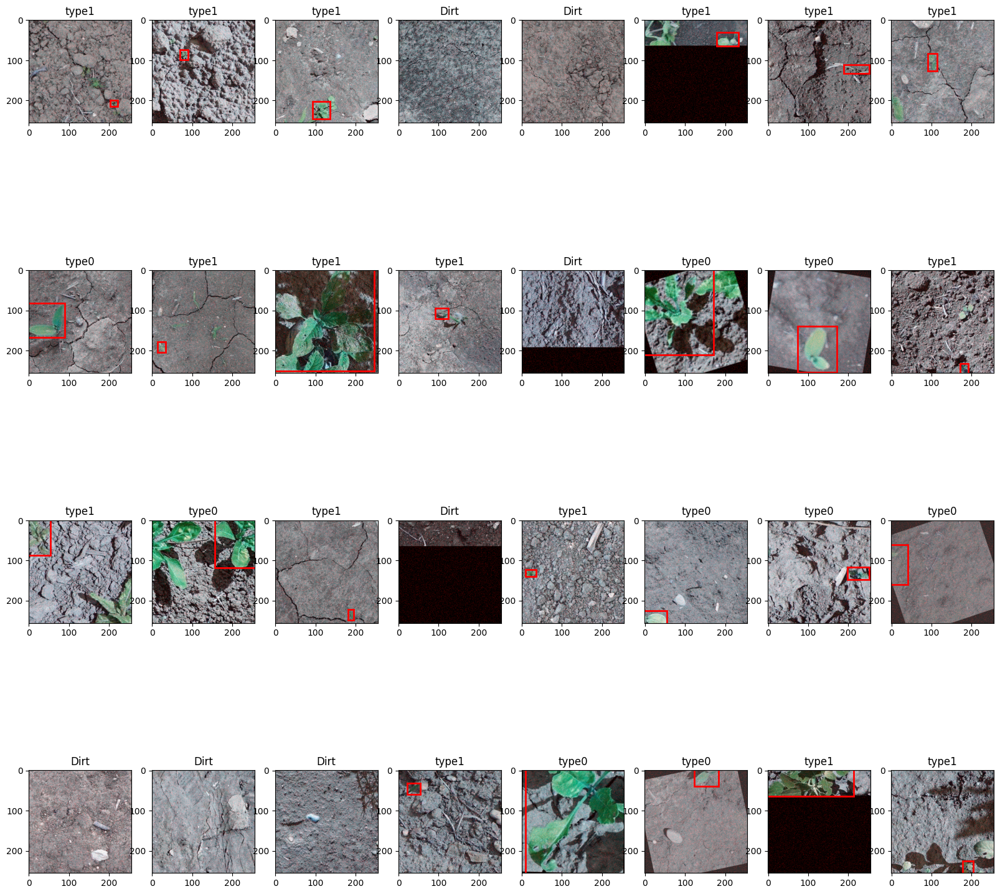

In [134]:
image_sample ,presence_sample, label_sample, boxes_sample = next(iter(val_dataloader))

# Create a grid of subplots
fig, axs = plt.subplots(4, 8, figsize=(20, 20))

# Iterate over images and box coordinates
for i, (img, box) in enumerate(zip(image_sample, boxes_sample)):
    # Get the corresponding axes
    ax = axs[i // 8, i % 8]

    img = np.transpose(img, (1, 2, 0))

    # Display the image
    ax.imshow(img)

    # Display label
    if presence_sample[i] == 0:
        ax.set(title="Dirt")
    else:
        ax.set(title=f"{num_to_labels[label_sample[i][1].item()]}")

    # Add a rectangle to the plot with box coordinates
    box_coordinates = convert_to_corners(box)

    rect = patches.Rectangle((box_coordinates[0].item() * 256, box_coordinates[1].item() * 256),
                             256 * (box_coordinates[2].item() - box_coordinates[0].item()),
                             256 * (box_coordinates[3].item() - box_coordinates[1].item()),
                             linewidth=2, edgecolor='r', facecolor='none')

    # Add the rectangle to the axes
    ax.add_patch(rect)

# Show the plot
plt.show()

## Model

### Support functions

#### Get Number of Correct Predictions

This script defines a function to calculate the number of correct predictions given model predictions and ground truth labels.

- `get_num_correct`: Function that takes model predictions (`preds`) and ground truth labels (`labels`) as input and returns the number of correct predictions.


In [135]:
def get_num_correct(preds, labels):
    """
    Calculate the number of correct predictions given model predictions and ground truth labels.

    Args:
        preds (torch.Tensor): Model predictions.
        labels (torch.Tensor): Ground truth labels.

    Returns:
        int: Number of correct predictions.
    """
    return torch.round(preds).argmax(dim=1).eq(labels).sum().item()

#### Intersection over Union (IoU) Calculation

This script defines a function to calculate the Intersection over Union (IoU) between two bounding boxes.

- `intersection_over_union`: Function that takes two bounding boxes (`box_a` and `box_b`) as input and returns the IoU.


In [136]:
def intersection_over_union(box_a, box_b):
    """
    Calculate the Intersection over Union (IoU) between two bounding boxes.

    Args:
        box_a (list): Coordinates of the first bounding box [left, top, right, bottom].
        box_b (list): Coordinates of the second bounding box [left, top, right, bottom].

    Returns:
        float: Intersection over Union (IoU) score.
    """
    left_a, top_a, right_a, bottom_a = convert_to_corners(box_a)
    left_b, top_b, right_b, bottom_b = convert_to_corners(box_b)

    # Calculate the area of intersection
    x_left = max(left_a, left_b)
    y_top = max(top_a, top_b)
    x_right = min(right_a, right_b)
    y_bottom = min(bottom_a, bottom_b)

    intersection_area = max(0, x_right - x_left + 1) * max(0, y_bottom - y_top + 1)

    # Calculate the area of union
    area_a = (right_a - left_a + 1) * (bottom_a - top_a + 1)
    area_b = (right_b - left_b + 1) * (bottom_b - top_b + 1)
    union_area = area_a + area_b - intersection_area

    # Calculate IoU
    iou = intersection_area / union_area
    return iou

#### Model Parameter Count

This script defines a function to calculate the total number of trainable parameters in a PyTorch model.

- `param_count`: Function that takes a PyTorch model (`model`) as input and prints the total number of trainable parameters.


In [137]:
def param_count(model):
    """
    Calculate the total number of trainable parameters in a PyTorch model.

    Args:
        model (torch.nn.Module): PyTorch model.

    Returns:
        None: Prints the total number of parameters.
    """
    params = [p.numel() for p in model.parameters() if p.requires_grad]
    print('Total number of parameters: ', sum(params))

#### Rete

In [138]:
from PIL import Image
import torch
import torchvision
from torchvision.transforms import ToTensor
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt

import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import os
import pickle
import random
import time

This script defines a function to count the number of trainable parameters in a PyTorch model.

- `count_parameters`: Function that takes a PyTorch model (`model`) as input and returns the total number of trainable parameters.



In [139]:
def count_parameters(model):
    """
    Count the number of trainable parameters in a PyTorch model.

    Args:
        model (torch.nn.Module): PyTorch model.

    Returns:
        int: Total number of trainable parameters.
    """
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [140]:
model_list = []
weights_list = []

This script defines a function to train a PyTorch model using a specified optimizer, criterion, and number of epochs.

In [148]:
from torch.optim import Adam

# Function to train the PyTorch model
def train_model(model3, name_weights, num_of_epochs=5):
    # Define the optimizer and criterion
    optimizer = Adam(model3.parameters(), lr=0.001)
    criterion = nn.CrossEntropyLoss()

    # Lists to store metrics during training
    epochs = []
    losses = []
    iou_list = []
    accuracy_list = []

    # Loop over epochs
    for epoch in range(num_of_epochs):
        tot_loss = 0
        tot_correct = 0
        train_start = time.time()
        model3.train()
        total_number = 0
        iou = 0
        tot_correct_p = 0
        tot_correct_y = 0

        # Loop over batches in the training dataset
        for batch, (x, p, y, z) in enumerate(train_dataloader):
            # Move data to GPU if available
            x, p, y, z = x.to(device), p.to(device), y.to(device), z.to(device)
            # Zero the gradients
            optimizer.zero_grad()
            # Forward pass
            [p_pred, y_pred, z_pred] = model3(x)
            # Compute loss
            pred_loss = criterion(p_pred, p)
            class_loss = criterion(y_pred, y)
            box_loss = F.mse_loss(z_pred, z)
            (pred_loss + box_loss + class_loss).backward()
            # Update weights
            optimizer.step()

            # Print progress every 20 batches
            if (batch + 1) % 20 == 0:
                print("Train batch:", batch + 1, " epoch: ", epoch, " ")

        # Evaluation on the validation dataset
        model3.eval()

        for batch, (x, p, y, z) in enumerate(val_dataloader):
            # Move data to GPU if available
            x, p, y, z = x.to(device), p.to(device), y.to(device), z.to(device)
            # Zero the gradients
            optimizer.zero_grad()

            with torch.no_grad():
                [p_pred, y_pred, z_pred] = model3(x)
                # Compute loss
                pred_loss = criterion(p_pred, p)
                class_loss = criterion(y_pred, y)
                box_loss = F.mse_loss(z_pred, z)

            # Print progress every 20 batches
            if (batch + 1) % 20 == 0:
                print("Val batch:", batch + 1, " epoch: ", epoch, " ")

            tot_loss += (pred_loss.item() + class_loss.item() + box_loss.item())

            for i in range(len(z_pred) - 1):
                iou += intersection_over_union(z_pred[i], z[i]).item()

            tot_correct_p += torch.round(p_pred).eq(p).sum().item()
            tot_correct_y += torch.round(y_pred).argmax(dim=1).eq(torch.round(y).argmax(dim=1)).sum().item()

            total_number += len(y)

        # Store metrics for plotting and analysis
        epochs.append(epoch)
        accuracy_list.append((tot_correct) / total_number * 100)
        iou_list.append((iou) / total_number)
        losses.append(tot_loss / total_number)

        # Print metrics for the current epoch
        print("Epoch", epoch, "Presence Accuracy: ", (tot_correct_p) / total_number * 100, "Class Accuracy: ",
              (tot_correct_y) / total_number * 100, "IOU: ", (iou) / total_number, "loss:", tot_loss / total_number)

    # Save model weights
    torch.save(model3.state_dict(), name_weights + ".pth")
    weights_list.append(model3.state_dict())

    return accuracy_list, iou_list, losses


### 1. Deep model with final split


This code defines a custom Convolutional Neural Network (CNN) model using PyTorch. The model architecture consists of several convolutional layers followed by fully connected layers for tasks related to presence detection, classification, and bounding box regression.

- **Network Architecture:**
  1. Convolutional Layers:
      - Conv1: 3 input channels, 16 output channels, kernel size 3, padding 1.
      - ReLU Activation and Batch Normalization.
      - Max Pooling with kernel size 2.
      - Conv2: 16 input channels, 32 output channels, kernel size 3, padding 1.
      - Conv3: 32 input channels, 64 output channels, kernel size 3, padding 1.
      - Conv4: 64 input channels, 128 output channels, kernel size 3, padding 1.
      - Conv5: 128 input channels, 256 output channels, kernel size 3, padding 1.
  2. Flatten Layer.
  3. Fully Connected Layer:
      - Linear layer with 16384 input features and 256 output features.
  4. Task-specific Fully Connected Layers:
      - Presence: Linear layer with 256 input features and 1 output feature (Sigmoid activation).
      - Classification: Linear layer with 256 input features and 2 output features (Softmax activation).
      - Bounding Box Regression: Linear layer with 256 input features and 4 output features.

- **Forward Pass:**
  - Passes the input through convolutional layers with ReLU activation and max pooling.
  - Flattens the output for the fully connected layer.
  - Applies ReLU activation for the fully connected layer.
  - Outputs predictions for presence (Sigmoid), class (Softmax), and bounding box.

- **Note:**
  - The model assumes an input size of (batch_size, 3, height, width).
  - The model is initialized as an instance of the `CustomModel` class.

In [57]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class CustomModel(nn.Module):
    def __init__(self):
        super(CustomModel, self).__init__()

        # Convolutional layers
        self.conv_layers = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(16),
            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(16, 32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(32),
            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(256),
            nn.MaxPool2d(kernel_size=2)
        )

        self.flatten = nn.Flatten()
        self.fc = nn.Linear(16384, 256)
        self.presence = nn.Linear(256, 1)
        self.class_out = nn.Linear(256, 2)
        self.box_out = nn.Linear(256, 4)

    def forward(self, x):
        x = self.conv_layers(x)
        x = self.flatten(x)
        x = F.relu(self.fc(x))

        presence_output = torch.sigmoid(self.presence(x))
        class_output = F.softmax(self.class_out(x), dim=1)
        box_output = self.box_out(x)

        return presence_output, class_output, box_output

# Instantiate your model
model1 = CustomModel()

# Print the model summary
print(model1)

CustomModel(
  (conv_layers): Sequential(
    (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): ReLU()
    (6): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (8): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU()
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (12): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU()
    (14): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_

In [ ]:
count_parameters(model1)

4589959

In [ ]:
train_model(model1,"model1")

### 2. Model with split in the middle

This code defines a Convolutional Neural Network (CNN) model for multi-task learning using PyTorch. The model is designed for tasks related to presence detection, classification, and bounding box regression.

- **Network Architecture:**
  1. Convolutional Layers:
      - Conv1: 3 input channels, 6 output channels, kernel size 5.
      - Conv2: 6 input channels, 12 output channels, kernel size 5.
      - Conv3: 12 input channels, 24 output channels, kernel size 5.
      - Conv4: 24 input channels, 48 output channels, kernel size 5.
      - Conv5: 48 input channels, 192 output channels, kernel size 5.
  2. Fully Connected Layers for Presence Prediction:
      - Presence_fc1: Linear layer with 1728 input features and 240 output features.
      - Presence_fc2: Linear layer with 240 input features and 120 output features.
      - Presence_out: Linear layer with 120 input features and 1 output feature.
  3. Fully Connected Layers for Classification:
      - Class_fc1: Linear layer with 1728 input features and 240 output features.
      - Class_fc2: Linear layer with 240 input features and 120 output features.
      - Class_out: Linear layer with 120 input features and 2 output features.
  4. Fully Connected Layers for Bounding Box Regression:
      - Box_fc1: Linear layer with 1728 input features and 240 output features.
      - Box_fc2: Linear layer with 240 input features and 120 output features.
      - Box_out: Linear layer with 120 input features and 4 output features.

- **Forward Pass:**
  - Passes the input through convolutional layers with ReLU activation and max/average pooling.
  - Flattens the output for fully connected layers.
  - Applies ReLU activation for intermediate fully connected layers.
  - Applies Sigmoid activation for presence prediction.
  - Applies Softmax activation for classification prediction.
  - Outputs predictions for presence, class, and bounding box.

- **Note:**
  - The model assumes an input size of (batch_size, 3, height, width).
  - The model is initialized as an instance of the `Network` class.


In [145]:
class Network(nn.Module):
    def __init__(self):
        super(Network, self).__init__()

        # CNNs for rgb images
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=6, kernel_size=5)
        self.conv2 = nn.Conv2d(in_channels=6, out_channels=12, kernel_size=5)
        self.conv3 = nn.Conv2d(in_channels=12, out_channels=24, kernel_size=5)
        self.conv4 = nn.Conv2d(in_channels=24, out_channels=48, kernel_size=5)
        self.conv5 = nn.Conv2d(in_channels=48, out_channels=192, kernel_size=5)

        # Connecting CNN outputs with Fully Connected layers for prediction
        self.presence_fc1 = nn.Linear(in_features=1728, out_features=240)
        self.presence_fc2 = nn.Linear(in_features=240, out_features=120)
        self.presence_out = nn.Linear(in_features=120, out_features=1)

        # Connecting CNN outputs with Fully Connected layers for classification
        self.class_fc1 = nn.Linear(in_features=1728, out_features=240)
        self.class_fc2 = nn.Linear(in_features=240, out_features=120)
        self.class_out = nn.Linear(in_features=120, out_features=2)

        # Connecting CNN outputs with Fully Connected layers for bounding box
        self.box_fc1 = nn.Linear(in_features=1728, out_features=240)
        self.box_fc2 = nn.Linear(in_features=240, out_features=120)
        self.box_out = nn.Linear(in_features=120, out_features=4)


    def forward(self, t):
        # Pass through the convolutional layers with ReLU activation and max/average pooling
        t = self.conv1(t)
        t = F.relu(t)
        t = F.max_pool2d(t, kernel_size=2, stride=2)

        t = self.conv2(t)
        t = F.relu(t)
        t = F.max_pool2d(t, kernel_size=2, stride=2)

        t = self.conv3(t)
        t = F.relu(t)
        t = F.max_pool2d(t, kernel_size=2, stride=2)

        t = self.conv4(t)
        t = F.relu(t)
        t = F.max_pool2d(t, kernel_size=2, stride=2)

        t = self.conv5(t)
        t = F.relu(t)
        t = F.avg_pool2d(t, kernel_size=4, stride=2)

        t = torch.flatten(t, start_dim=1)

        # Presence Task
        presence_t = self.presence_fc1(t)
        presence_t = F.relu(presence_t)
        presence_t = self.presence_fc2(presence_t)
        presence_t = F.relu(presence_t)
        presence_t = torch.sigmoid(self.presence_out(presence_t))

        # Class Task
        class_t = self.class_fc1(t)
        class_t = F.relu(class_t)
        class_t = self.class_fc2(class_t)
        class_t = F.relu(class_t)
        class_t = F.softmax(self.class_out(class_t), dim=1)

        # Box Task
        box_t = self.box_fc1(t)
        box_t = F.relu(box_t)
        box_t = self.box_fc2(box_t)
        box_t = F.relu(box_t)
        box_t = self.box_out(box_t)

        return [presence_t, class_t, box_t]

# Instantiate your model
model2 = Network()

# Print the model summary
print(model2)

Network(
  (conv1): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
  (conv2): Conv2d(6, 12, kernel_size=(5, 5), stride=(1, 1))
  (conv3): Conv2d(12, 24, kernel_size=(5, 5), stride=(1, 1))
  (conv4): Conv2d(24, 48, kernel_size=(5, 5), stride=(1, 1))
  (conv5): Conv2d(48, 192, kernel_size=(5, 5), stride=(1, 1))
  (presence_fc1): Linear(in_features=1728, out_features=240, bias=True)
  (presence_fc2): Linear(in_features=240, out_features=120, bias=True)
  (presence_out): Linear(in_features=120, out_features=1, bias=True)
  (class_fc1): Linear(in_features=1728, out_features=240, bias=True)
  (class_fc2): Linear(in_features=240, out_features=120, bias=True)
  (class_out): Linear(in_features=120, out_features=2, bias=True)
  (box_fc1): Linear(in_features=1728, out_features=240, bias=True)
  (box_fc2): Linear(in_features=240, out_features=120, bias=True)
  (box_out): Linear(in_features=120, out_features=4, bias=True)
)


In [ ]:
model_list.append(model2)

In [146]:
count_parameters(model2)

1601419

In [ ]:
train_model(model2,"model2")

### 3. Model with bifurcations

This code defines a Bifurcated Convolutional Neural Network (CNN) model using PyTorch. The model is designed for image classification and bounding box regression tasks.

- **Network Architecture:**
  1. Three sets of Convolutional Layers:
      - Conv1: 3 input channels, 16 output channels, kernel size 3, padding 1, ReLU activation, Batch Normalization, and Max Pooling.
      - Conv2: 16 input channels, 32 output channels, kernel size 3, padding 1, ReLU activation, Batch Normalization, and Max Pooling.
      - Conv3: 32 input channels, 64 output channels, kernel size 3, padding 1, ReLU activation, Batch Normalization, and Max Pooling.
  2. Three Fully Connected Layers for each task:
      - Presence Task (p): Linear layer with 128 input features and 16 output features.
      - Class Task (c): Linear layer with 64 input features and 16 output features.
      - Box Task (b): Linear layer with 32 input features and 16 output features.
  3. Output Layers:
      - Presence Task (p): Linear layer with 32768 input features and 64 output features.
      - Class Task (c): Linear layer with 32768 input features and 64 output features.
      - Box Task (b): Linear layer with 32768 input features and 64 output features.
  4. Final Output:
      - Presence Task (p): Sigmoid activation for binary classification.
      - Class Task (c): Softmax activation for multi-class classification.
      - Box Task (b): Linear output for bounding box regression.

- **Forward Pass:**
  - Passes the input through convolutional layers and flattens the output.
  - Each task (presence, class, box) has a separate set of fully connected layers.
  - Applies ReLU activation and Batch Normalization for intermediate layers.
  - Applies Sigmoid activation for presence prediction, Softmax activation for class prediction.
  - Outputs predictions for presence, class, and bounding box.

- **Note:**
  - The model assumes an input size of (batch_size, 3, height, width).
  - The model is initialized as an instance of the `Model_bif` class.

In [59]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class Model_bif(nn.Module):
    def __init__(self):
        super(Model_bif, self).__init__()

        # Convolutional Layers: Define three sets of convolutional layers with ReLU activation, Batch Normalization, and Max Pooling.
        self.conv_layers1 = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(16),
            nn.MaxPool2d(kernel_size=2)
        )

        self.conv_layers2 = nn.Sequential(
            nn.Conv2d(16, 32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(32),
            nn.MaxPool2d(kernel_size=2)
        )

        self.conv_layers3 = nn.Sequential(
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.MaxPool2d(kernel_size=2)
        )

        # Fully Connected Layers: Define three fully connected layers for each task (presence, class, box).
        self.fc1 = nn.Linear(128, 16)
        self.fc2 = nn.Linear(64, 16)
        self.fc3 = nn.Linear(32, 16)

        # Flatten Layer: Flatten the output for fully connected layers.
        self.flatten = nn.Flatten()

        # Output Layers: Define linear layers for each task (presence, class, box).
        self.fc_p = nn.Linear(32768, 64)
        self.presence_out = nn.Linear(64, 1)

        self.fc_c = nn.Linear(32768, 64)
        self.class_out = nn.Linear(64, 2)

        self.fc_b = nn.Linear(32768, 64)
        self.box_out = nn.Linear(64, 4)

    def forward(self, x):
        # Pass through the first set of convolutional layers
        x = self.conv_layers1(x)

        # Presence Task
        presence = F.relu(self.fc1(x))
        presence = self.flatten(presence)
        presence = self.fc_p(presence)
        presence_output = torch.sigmoid(self.presence_out(presence))

        # Pass through the second set of convolutional layers
        x = self.conv_layers2(x)

        # Class Task
        class_o = F.relu(self.fc2(x))
        class_o = self.flatten(class_o)
        class_o = self.fc_c(class_o)
        class_output = F.softmax(self.class_out(class_o), dim=1)

        # Pass through the third set of convolutional layers
        x = self.conv_layers3(x)

        # Box Task
        box = F.relu(self.fc3(x))
        box = self.flatten(box)
        box = self.fc_b(box)
        box_output = self.box_out(box)

        return presence_output, class_output, box_output

# Instantiate your model
model3 = Model_bif()


In [ ]:
count_parameters(model3)

6319543

In [ ]:
train_model(model3,"model3")

### 4. Model with 1x1 filters

This code defines a Convolutional Neural Network (CNN) classifier using PyTorch. The network is designed for image classification tasks.

- **Network Architecture:**
  1. Convolutional Layer 1:
      - Input Channels: 3 (RGB images)
      - Output Channels: 16
      - Kernel Size: 3x3
      - Stride: 1
      - Padding: 1
  2. Max Pooling Layer:
      - Kernel Size: 2x2
      - Stride: 2
  3. Convolutional Layer 2:
      - Output Channels: 400
      - Kernel Size: 5x5
  4. Max Pooling Layer:
      - Kernel Size: 2x2
      - Stride: 2
  5. Output Layers:
      - Output Probability (p) Prediction: 1 channel
      - Output Class (c) Prediction: 2 channels (using softmax activation)
      - Output Bounding Box (b) Prediction: 4 channels

- **Forward Pass:**
  - Passes the input through convolutional layers and pooling.
  - Utilizes 1x1 filters in place of fully connected layers.
  - Computes mean across spatial dimensions.
  - Applies sigmoid activation for probability prediction (p).
  - Applies softmax activation for class prediction (c).
  - Outputs predictions for probability, class, and bounding box.

- **Note:**
  - The model assumes an input size of (32, 3, H, W) where H and W are the height and width of the input images, respectively.
  - The model is initialized as an instance of the `CNNClassifier` class.

In [ ]:
import torch
import torch.nn as nn

class CNNClassifier(nn.Module):
    def __init__(self):
        super(CNNClassifier, self).__init__()

        # Convolutional Layers
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding=1)

        # Max pooling
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        # 1x1 Filters instead of Fully Connected layers
        self.conv4 = nn.Conv2d(in_channels=16, out_channels=400, kernel_size=5)

        # Max pooling
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.output_p = nn.Conv2d(in_channels=400, out_channels=1, kernel_size=1)
        self.output_c = nn.Conv2d(in_channels=400, out_channels=2, kernel_size=1)
        self.output_b = nn.Conv2d(in_channels=400, out_channels=4, kernel_size=1)


    def forward(self, x):
        # Pass through convolutional layers
        x = self.pool(torch.relu(self.conv1(x)))

        # 1x1 Filters instead of Fully Connected layers
        x = self.conv4(x)

        x = torch.mean(x, dim=(2, 3), keepdim=True)

        p = torch.sigmoid(self.output_p(x))
        c = F.softmax(self.output_c(x), dim=1)
        b = self.output_b(x)

        return p.view(32, 1), c.view(32, 2), b.view(32, 4)

# Instantiate your model
model4 = CNNClassifier()


In [ ]:
# Defining the optimizer
from torch.optim import Adam
optimizer=Adam(model4.parameters(),lr=0.001)
criterion=nn.CrossEntropyLoss()

epochs = []
losses = []
iou_list = []
accuracy_list = []

num_of_epochs = 10

for epoch in range(num_of_epochs):
    tot_loss = 0
    tot_correct = 0
    train_start = time.time()
    model4.train()
    total_number = 0
    iou = 0
    tot_correct_p = 0
    tot_correct_y = 0
    for batch, (x, p, y, z) in enumerate(train_dataloader):
    # Converting data from cpu to GPU if available to improve speed
        x,p,y,z = x.to(device),p.to(device),y.to(device),z.to(device)
        # Sets the gradients of all optimized tensors to zero
        if x.shape == torch.Size([32, 3, 256, 256]):
            optimizer.zero_grad()
            [p_pred,y_pred,z_pred]= model4(x)
            #print(p_pred.shape, y_pred.shape, z_pred.shape)

            # Compute loss (here CrossEntropyLoss)
            pred_loss = criterion(p_pred, p)
            class_loss = criterion(y_pred, y)
            box_loss = F.mse_loss(z_pred, z)
            (pred_loss + box_loss + class_loss).backward()

            optimizer.step()
            print("Train batch:", batch+1, " epoch: ", epoch, " ")


    model4.eval()

    for batch, (x, p, y, z) in enumerate(val_dataloader):
    # Converting data from cpu to GPU if available to improve speed
        x,p,y,z = x.to(device),p.to(device),y.to(device),z.to(device)
        # Sets the gradients of all optimized tensors to zero
        if x.shape == torch.Size([32, 3, 256, 256]):
            optimizer.zero_grad()
            with torch.no_grad():

                [p_pred,y_pred,z_pred]= model4(x)

                # Compute loss
                pred_loss = criterion(p_pred, p)
                class_loss = criterion(y_pred, y)
                box_loss = F.mse_loss(z_pred, z)

            print("Val batch:", batch+1, " epoch: ", epoch, " ")

            tot_loss += (pred_loss.item() + class_loss.item() + box_loss.item())


            for i in range(len(z_pred)-1):
                iou += intersection_over_union(z_pred[i],z[i]).item()

                tot_correct_p += torch.round(p_pred).eq(p).sum().item()
                tot_correct_y += torch.round(y_pred).argmax(dim=1).eq(torch.round(y).argmax(dim=1)).sum().item()

                total_number += len(y)


    epochs.append(epoch)
    accuracy_list.append((tot_correct)/total_number * 100)
    iou_list.append((iou)/total_number)
    losses.append(tot_loss/total_number)

    print("Epoch", epoch, "Presence Accuracy: ", (tot_correct_p)/total_number * 100, "Class Accuracy: ", (tot_correct_y)/total_number * 100 , "IOU: ", (iou)/total_number, "loss:", tot_loss/total_number)

torch.save(model4.state_dict(), "model4"+".pth")
weights_list.append(model4.state_dict())


### Test models

#### Support functions

##### Calculate Rectangle Area

This script defines a function to calculate the area of a rectangle.

- `calcola_area_rettangolo`: Function that takes the coordinates of two opposite corners of a rectangle (`x1, y1, x2, y2`) and returns the area of the rectangle.


In [71]:
def calcola_area_rettangolo(x1, y1, x2, y2):
    """
    Calculate the area of a rectangle.

    Args:
        x1, y1, x2, y2 (float): Coordinates of two opposite corners of the rectangle.

    Returns:
        float: Area of the rectangle.
    """
    # Calculate length and width
    length = abs(x2 - x1)
    width = abs(y2 - y1)

    # Calculate the area
    area = length * width

    return area


##### Postprocess Function

This script defines a postprocess function that extracts meaningful information from the model predictions.

- `postprocess`: Function that takes the original image and the model's output and returns the presence status, class label, bounding box coordinates, and confidence score.



In [84]:
def postprocess(image, results):
    """
    Extracts meaningful information from the model predictions.

    Args:
        image (PIL.Image.Image): Original image.
        results (list): Model predictions containing presence, class, and bounding box information.

    Returns:
        tuple: Tuple containing presence status, class label, bounding box coordinates, and confidence score.
    """
    # Split the results into class probabilities and box coordinates
    [presence_output, class_output, box_output] = results

    # Round the presence output to 0 or 1
    presence_output = torch.round(presence_output).item()

    # The index of the class with the highest confidence is our target class
    class_index = torch.argmax(class_output)

    # Use this index to get the class name
    class_label = num_to_labels[class_index.item()]

    # Get the height and width of the actual image
    h, w = 256, 256

    # Extract the coordinates
    x1, y1, x2, y2 = box_output[0]

    # Convert the coordinates from relative (0-1) to actual values
    x1 = int(w * x1)
    x2 = int(w * x2)
    y1 = int(h * y1)
    y2 = int(h * y2)

    # Check if the confidence is below a threshold or the area is too small
    if class_output[0][class_index.item()] < 0.7 or calcola_area_rettangolo(x1, y1, x2, y2) < 256 * 256 // 9:
        presence_output = 0
        class_label = num_to_labels[2]
        x1 = 0
        x2 = 0
        y1 = 0
        y2 = 0

    # Return the presence status, class label, bounding box coordinates, and confidence score
    return presence_output, class_label, (x1, y1, x2, y2), class_output[0][class_index.item()].item()
          

##### Union Bounding boxes

In [69]:
import pandas as pd

def union_bounding_boxes_with_label(df):
    """
    Unites bounding boxes with the same label efficiently, placing the resulting box centrally.

    Args:
    - df: Pandas DataFrame with columns 'Left', 'Top', 'Right', 'Bottom', 'Label'.

    Returns:
    - Pandas DataFrame: DataFrame with the resulting bounding box after union.
    """
    if df.empty:
        return pd.DataFrame()

    # Sort the DataFrame based on the 'Left' column
    df_sorted = df.sort_values(by='Left')

    result_boxes = [df_sorted.iloc[0]]

    for i in range(1, len(df_sorted)):
        # Current bounding box
        box = df_sorted.iloc[i]

        # Previous bounding box in the resulting list
        last_box = result_boxes[-1]

        # Check if the bounding boxes have the same label
        if box['Label'] == last_box['Label']:
            # Calculate the coordinates of the resulting bounding box positioned centrally
            x_min = min(box['Left'], last_box['Left'])
            y_min = min(box['Top'], last_box['Top'])
            x_max = max(box['Right'], last_box['Right'])
            y_max = max(box['Bottom'], last_box['Bottom'])

            result_center_x = (x_min + x_max) / 2
            result_center_y = (y_min + y_max) / 2

            result_width = x_max - x_min
            result_height = y_max - y_min

            # Union of bounding boxes with centroid
            result_boxes[-1] = pd.Series({
                'Left': result_center_x - result_width / 2,
                'Top': result_center_y - result_height / 2,
                'Right': result_center_x + result_width / 2,
                'Bottom': result_center_y + result_height / 2,
                'Label': box['Label']  # Keep the same label
            })
        else:
            # If bounding boxes have different labels, add them without merging
            result_boxes.append(box)

    # Create a new DataFrame with the resulting bounding box
    result_df = pd.DataFrame(result_boxes)

    return result_df




##### Predict funcion

This Python function is designed to make predictions on images using a pre-trained neural network model. The function takes an input image, a pre-trained model, and corresponding weights. It performs preprocessing on the image, makes predictions using the model, and then postprocesses the results to annotate the image.

- **Parameters:**
  - `image`: Input image file path.
  - `model`: Pre-trained neural network model.
  - `weights`: File path to the pre-trained weights for the model.
  - `scale`: Scaling factor for font size in the annotation (default is 0.5).

- **Steps:**
  1. Load pre-trained weights for the model.
  2. Set the model to evaluation mode.
  3. Read the input image using OpenCV.
  4. Preprocess the image using the `preprocess` function.
  5. Make predictions using the pre-trained model.
  6. Postprocess the results to obtain relevant information.
  7. If presence is detected, annotate the image with bounding box and class label.
  8. Display the annotated image using matplotlib.


In [68]:
# We will use this function to make prediction on images.
def predict(image, model, weights, scale=0.5):
  # Load the pre-trained weights for the model
  model.load_state_dict(torch.load(weights))
  model.eval()

  # Read the input image using OpenCV
  img = cv2.imread(image)

  # Before making a prediction, preprocess the image
  processed_image = preprocess(img)

  # Make a prediction using the pre-trained model
  result = model(torch.permute(torch.from_numpy(processed_image).float(), (0, 3, 1, 2)).to(device))

  # After obtaining the result, postprocess it to get relevant information
  presence_output, class_label, (x1, y1, x2, y2) = postprocess(image, result)

  if presence_output == 1:
    # If the presence is detected, annotate the image
    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 100), 2)
    cv2.putText(
        img,
        'Class: {}'.format(class_label),
        (30, int(35 * scale)),
        cv2.FONT_HERSHEY_COMPLEX, scale,
        (200, 55, 100),
        2
    )

  # Show the annotated image using matplotlib
  plt.figure(figsize=(5, 5))
  plt.imshow(img[:, :, ::-1])
  # print(presence_output, class_label)


#### Test casuali

In [ ]:
# type 0
for _ in range(10):
    random_number = random.randint(0, len(df_train[df_train["type0"] == 1]))
    image = "data/immagini_piccole/" + df_train[df_train["type0"] == 1]["name"].iloc[random_number]
    predict(image,model3,"model3.pth")

In [ ]:
#type1
for _ in range(10):
    random_number = random.randint(0, len(df_train[df_train["type1"] == 1]))
    image = "data/immagini_piccole/" + df_train[df_train["type1"] == 1]["name"].iloc[random_number]
    predict(image,model2,"model2.pth")


In [ ]:
#dirt
for _ in range(10):
    random_number = random.randint(0, len(df_train[df_train["presence"] == 0]))
    image = "data/immagini_piccole/" + df_train[df_train["presence"] == 0]["name"].iloc[random_number]
    predict(image,model2,"model2.pth")


#### Test su immagine intera

In [76]:
with open('data/test_split.txt') as f:
    test_list = f.readlines()

This function performs preprocessing on an input image.

- **Parameters:**
  - `img`: Input image to be preprocessed.
  - `image_size`: Target size for resizing the image (default is 256).

- **Processing Steps:**
  1. Resize the input image to the specified `image_size`.
  2. Adjust contrast and brightness randomly using `convertScaleAbs` function.
  3. Generate random Gaussian noise with a specified mean and standard deviation.
  4. Add the generated noise to the image.
  5. Normalize the image values to the range [0, 1].
  6. Expand dimensions to conform to the expected input shape for prediction (batch dimension).

- **Returns:**
  - Preprocessed image ready for input to a neural network.

In [75]:
def preprocess(img, image_size = 256):

    image = cv2.resize(img, (image_size, image_size))


    # define the alpha and beta
    alpha = random.randint(1, 3) # Contrast control [1-3]
    beta = random.uniform(0, 100) # Brightness control [0-100]

    # call convertScaleAbs function
    adjusted_image = cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

    # Generate random Gaussian noise
    mean = 0
    stddev = 40
    noise = np.zeros(img.shape, np.uint8)
    cv2.randn(noise, mean, stddev)

    # Add noise to image
    adjusted_image = cv2.add(img, noise)

    image = adjusted_image.astype("float") / 255.0

    # Expand dimensions as predict expect image in batches
    image = np.expand_dims(image, axis=0)
    return image

This function is designed to make predictions on test images using a pre-trained model.

- **Parameters:**
  - `image`: Input image for prediction.
  - `model`: Pre-trained model for object detection.
  - `weights`: Path to the model weights to be loaded.
  - `scale`: Scaling factor for the image (default is 0.5).

- **Processing Steps:**
  1. Load the pre-trained model weights.
  2. Set the model to evaluation mode.
  3. Preprocess the input image using the `preprocess` function.
  4. Perform the prediction on the preprocessed image.
  5. Postprocess the prediction results.
  6. Return the output indicating presence, class label, bounding box coordinates, and confidence.

- **Returns:**
  - Tuple containing presence output, class label, bounding box coordinates, and confidence.


In [61]:

# We will use this function to make prediction on images.
def predict_for_test(image, model,weights, scale = 0.5):
  model.load_state_dict(torch.load(weights))
  model.eval()

  # Reading Image
  #img  = cv2.imread(image)

  # # Before we can make a prediction we need to preprocess the image.
  processed_image = preprocess(image)

  result = model(torch.permute(torch.from_numpy(processed_image).float(),(0,3,1,2)).to(device))

  # After postprocessing, we can easily use our results
  presence_output, class_label, (x1,y1,x2,y2), confidence = postprocess(image, result)

  return presence_output, class_label, (x1,y1,x2,y2), confidence

This section reads the test data from a text file named 'test_split.txt' and defines functions for creating masks and calculating Intersection over Union (IoU).

1. Read Test Data
- `with open('data/test_split.txt') as f:`: Opens the file 'test_split.txt' located in the 'data' directory.
- `test_list = f.readlines()`: Reads all lines from the file and stores them in the variable `test_list`.

2. Mask Creation Functions
- `create_mask(csv)`: Creates two masks (mask0 and mask1) based on the provided DataFrame (`csv`).
- `calculate_iou(mask1, mask0)`: Calculates the Intersection over Union (IoU) between two masks.


In [62]:
with open('data/test_split.txt') as f:
    test_list = f.readlines()

def create_mask(csv):
    # Initialize masks with zeros
    mask0 = np.zeros((1920, 1088), dtype=np.int)
    mask1 = np.zeros((1920, 1088), dtype=np.int)

    # Iterate over the DataFrame and update the masks
    for index, row in csv.iterrows():
        left, top, right, bottom, label = int(row["Left"]), int(row["Top"]), int(row["Right"]), int(row["Bottom"]), row["Label"]

        # Set values in mask0 if the label is 0 or 'type0'
        if label == 0 or label == 'type0':
            mask0[top:bottom, left:right] = 1

        # Set values in mask1 if the label is 1 or 'type1'
        elif label == 1 or label == 'type1':
            mask1[top:bottom, left:right] = 1

    return mask0, mask1

def calculate_iou(mask1, mask0):
    # Calculate the intersection between the masks
    intersection = np.logical_and(mask1, mask0)

    # Calculate the union between the masks
    union = np.logical_or(mask1, mask0)

    # Calculate the IoU
    iou = np.sum(intersection) / np.sum(union)

    return iou

This function merges two masks using the logical OR operation.

- **Parameters:**
  - `mask1`: First input mask.
  - `mask2`: Second input mask.

- **Processing Steps:**
  - Use the logical OR operator to obtain a mask with 1 where there is a 1 in at least one of the input masks.

- **Returns:**
  - Merged mask with 1 at locations where there is a 1 in at least one of the input masks.


In [63]:
def merge_masks(mask1, mask2):
    # Use the logical OR operator to obtain a mask with 1 where there is a 1 in at least one of the masks
    merged_mask = np.logical_or(mask1, mask2).astype(int)

    return merged_mask

### Test

This code snippet visualizes and compares the predictions of multiple models on randomly selected test images.

- **Parameters:**
  - `number_of_images`: Number of images to display (set to 2).
  - `dimensione_blocco`: Size of the image blocks (set to 256).

- **Visualization Steps:**
  1. Define the dimensions of the grid for subplots.
  2. Create a figure with an appropriate number of subplots.
  3. Add a visible grid to each subplot.
  4. Iterate over the specified number of images.
  5. Load a random image and its corresponding bounding box information.
  6. Display the original image with bounding box rectangles.
  7. For each model, make predictions on image blocks and display the predicted bounding boxes.
  8. Calculate and display accuracy metrics for each model.


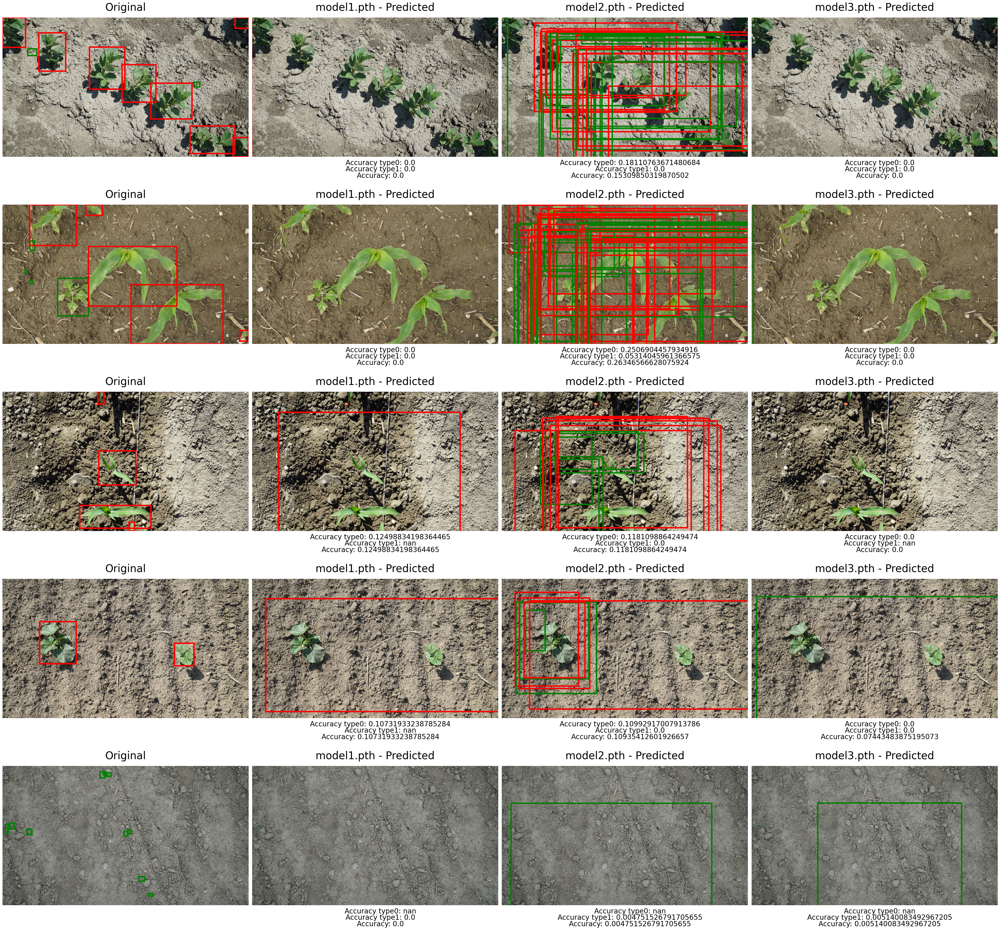

In [158]:
from matplotlib.patches import Rectangle
from scipy.ndimage import binary_fill_holes
import cv2
import warnings
warnings.filterwarnings("ignore")

number_of_images = 5
dimensione_blocco = 256

# Define the dimensions of the grid
num_rows = number_of_images
num_cols = 4

# Create a figure with an appropriate number of subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols*10, number_of_images * 7.5))

# Add a visible grid
for ax_row in axes:
    for ax in ax_row:
        ax.grid(True, linestyle='--', linewidth=0.5)

for i in range(number_of_images):
    # Load a random image and its bounding box information
    random_int = random.randint(0, len(test_list)-1)
    input_path = "data/images/" + test_list[random_int][:-1] + ".jpg"
    csv_path = "data/bboxes/CropOrWeed2/" + test_list[random_int][:-1] + ".csv"

    # Open the image
    immagine = Image.open(input_path)

    # Get the image dimensions
    larghezza, altezza = immagine.size

    df_image = pd.read_csv(csv_path, names=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

    j = 0

    # Display the original image
    axes[i, j].imshow(immagine)

    # Add rectangles for the original bounding boxes
    for index, row in df_image.iterrows():
        left, top, right, bottom, label = row["Left"], row["Top"], row["Right"], row["Bottom"], row["Label"]
        if label == 0:
            color = 'r'
        else:
            color = 'g'
        rect = Rectangle((left, top), right - left, bottom - top, linewidth=4, edgecolor=color, facecolor='none')
        axes[i, j].add_patch(rect)

    axes[i, j].axis('off')
    axes[i, j].set_title(f'Original', size=30, pad=20)

    j += 1

    for model, name_model in zip([model1, model2, model3], ["model1.pth", "model2.pth", "model3.pth"]):

        df_prediction = pd.DataFrame(columns=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

        for y in range(0, altezza, dimensione_blocco // 4):
            for x in range(0, larghezza, dimensione_blocco // 4):
                box = (x, y, x + dimensione_blocco, y + dimensione_blocco)
                blocco = immagine.crop(box)

                numpy_array = np.array(blocco)
                opencv_blocco = cv2.cvtColor(numpy_array, cv2.COLOR_RGB2BGR)

                presence_output, class_label, (centerX, centerY, W, H), confidence = predict_for_test(
                    opencv_blocco, model, name_model)

                if presence_output == 1:
                    centerX, centerY, W, H = centerX + x, centerY + y, W + x, H + y

                    left, top, right, bottom = centerX - W / 2, centerY - H / 2, centerX + W / 2, centerY + H / 2

                    df_prediction = df_prediction.append(
                        {"Left": left, "Top": top, "Right": right, "Bottom": bottom, "Label": class_label,
                         "StemX": centerX, "StemY": centerY}, ignore_index=True)

        axes[i, j].imshow(immagine)

        df_prediction = union_bounding_boxes_with_label(df_prediction)

        # Add rectangles for the predicted bounding boxes
        for index, row in df_prediction.iterrows():
            left, top, right, bottom, label = row["Left"], row["Top"], row["Right"], row["Bottom"], row["Label"]

            if label == 'type0':
                color = 'r'
            else:
                color = 'g'

            rect = Rectangle((left, top), right - left, bottom - top, linewidth=4, edgecolor=color, facecolor='none')
            axes[i, j].add_patch(rect)

        mask0_real, mask1_real = create_mask(df_image)
        mask0_pred, mask1_pred = create_mask(df_prediction)

        mask0_pred = binary_fill_holes(mask0_pred).astype(int)
        mask1_pred = binary_fill_holes(mask1_pred).astype(int)

        mask_real = merge_masks(mask0_real, mask1_real)
        mask_pred = merge_masks(mask0_pred, mask1_pred)

        acc0 = "Accuracy type0: " + str(calculate_iou(mask0_real, mask0_pred))
        acc1 = "Accuracy type1: " + str(calculate_iou(mask1_real, mask1_pred))
        acc = "Accuracy: " + str(calculate_iou(mask_real, mask_pred))

        axes[i, j].text(1000, 1150, acc0, size=20, ha='center')
        axes[i, j].text(1000, 1200, acc1, size=20, ha='center')
        axes[i, j].text(1000, 1250, acc, size=20, ha='center')

        axes[i, j].axis('off')
        axes[i, j].set_title(f'{name_model} - Predicted', size=30, pad=20)

        j += 1

plt.tight_layout()
plt.savefig('test_predict.png') 
plt.show()


This code snippet evaluates the accuracy of multiple models on the test images and generates a DataFrame containing accuracy metrics.

- **Parameters:**
  - `number_of_images`: Number of images to evaluate (set to the total number of test images).
  - `dimensione_blocco`: Size of the image blocks (set to 256).

- **Evaluation Steps:**
  1. Iterate over the test images.
  2. Load the image and its corresponding bounding box information.
  3. For each model, make predictions on image blocks and calculate accuracy metrics.
  4. Fill holes in the predicted masks using `binary_fill_holes`.
  5. Merge the predicted masks and calculate accuracy using the `calculate_iou` function.
  6. Store the accuracy metrics in a DataFrame (`df_accuracy`).


In [ ]:
from scipy.ndimage import binary_fill_holes

number_of_images = len(test_list)-1
dimensione_blocco = 256

df_accuracy = []


for i in range(number_of_images):

    input_path = "data/images/" + test_list[i][:-1] + ".jpg"
    csv_path = "data/bboxes/CropOrWeed2/" + test_list[i][:-1] + ".csv"

    # Open the image
    immagine = Image.open(input_path)

    # Get the image dimensions
    larghezza, altezza = immagine.size

    df_image = pd.read_csv(csv_path, names=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

    #for model, name_model in zip([model1, model2, model3], ["model1.pth", "model2.pth", "model3.pth"]):
    for model, name_model in zip([model2], ["model2.pth"]):

        df_prediction = pd.DataFrame(columns=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

        for y in range(0, altezza , dimensione_blocco//4):
            for x in range(0, larghezza , dimensione_blocco//4):
                box = (x, y, x + dimensione_blocco, y + dimensione_blocco)
                blocco = immagine.crop(box)

                numpy_array = np.array(blocco)
                opencv_blocco = cv2.cvtColor(numpy_array, cv2.COLOR_RGB2BGR)

                presence_output, class_label, (centerX, centerY, W, H), confidence = predict_for_test(
                    opencv_blocco, model, name_model)

                if presence_output == 1:
                    centerX, centerY, W, H = centerX + x, centerY + y, W + x, H + y

                    left, top, right, bottom = centerX - W / 2, centerY - H / 2, centerX + W / 2, centerY + H / 2

                    df_prediction = df_prediction.append(
                        {"Left": left, "Top": top, "Right": right, "Bottom": bottom, "Label": class_label,
                         "StemX": centerX, "StemY": centerY}, ignore_index=True)

        df_prediction = union_bounding_boxes_with_label(df_prediction)

        mask0_real, mask1_real = create_mask(df_image)
        mask0_pred, mask1_pred = create_mask(df_prediction)

        mask0_pred = binary_fill_holes(mask0_pred).astype(int)
        mask1_pred = binary_fill_holes(mask1_pred).astype(int)

        mask_real = merge_masks(mask0_real, mask1_real)
        mask_pred = merge_masks(mask0_pred, mask1_pred)

        acc0 = calculate_iou(mask0_real,mask0_pred)
        acc1 = calculate_iou(mask1_real,mask1_pred)
        acc = calculate_iou(mask_real,mask_pred)

        df_accuracy.append([test_list[i][:-1], name_model[:-4], acc0, acc1, acc])

        print("Done image", i, "/", number_of_images, name_model[:-4])

df_accuracy = pd.DataFrame(df_accuracy, columns=["name", "model", "acc0", "acc1", "acc"])
df_accuracy

Done image 0 / 1540 model1
Done image 0 / 1540 model2
Done image 0 / 1540 model3
Done image 1 / 1540 model1
Done image 1 / 1540 model2
Done image 1 / 1540 model3
Done image 2 / 1540 model1
Done image 2 / 1540 model2
Done image 2 / 1540 model3
Done image 3 / 1540 model1
Done image 3 / 1540 model2
Done image 3 / 1540 model3
Done image 4 / 1540 model1
Done image 4 / 1540 model2
Done image 4 / 1540 model3
Done image 5 / 1540 model1
Done image 5 / 1540 model2
Done image 5 / 1540 model3
Done image 6 / 1540 model1
Done image 6 / 1540 model2
Done image 6 / 1540 model3
Done image 7 / 1540 model1
Done image 7 / 1540 model2
Done image 7 / 1540 model3
Done image 8 / 1540 model1
Done image 8 / 1540 model2
Done image 8 / 1540 model3
Done image 9 / 1540 model1
Done image 9 / 1540 model2
Done image 9 / 1540 model3
Done image 10 / 1540 model1
Done image 10 / 1540 model2
Done image 10 / 1540 model3
Done image 11 / 1540 model1
Done image 11 / 1540 model2
Done image 11 / 1540 model3
Done image 12 / 1540 m

,name,model,acc0,acc1,acc
0,vwg-0709-0007,model1,0.000000,NaN,0.000000
1,vwg-0709-0007,model2,0.008089,0.000000,0.007889
2,vwg-0709-0007,model3,0.000000,0.000000,0.004487
3,vwg-0709-0007,model1,NaN,0.000000,0.000000
4,vwg-0709-0007,model2,NaN,0.007893,0.007893
...,...,...,...,...,...
4615,vwg-0709-0007,model2,NaN,0.035740,0.035740
4616,vwg-0709-0007,model3,NaN,0.034639,0.034639
4617,vwg-0709-0007,model1,NaN,0.000000,0.000000
4618,vwg-0709-0007,model2,NaN,0.024427,0.024427


In [ ]:
from scipy.ndimage import binary_fill_holes

number_of_images = len(test_list)-1
dimensione_blocco = 256

df_accuracy = []


for i in range(number_of_images):

    input_path = "data/images/" + test_list[i][:-1] + ".jpg"
    csv_path = "data/bboxes/CropOrWeed2/" + test_list[i][:-1] + ".csv"

    # Open the image
    immagine = Image.open(input_path)

    # Get the image dimensions
    larghezza, altezza = immagine.size

    df_image = pd.read_csv(csv_path, names=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

    #for model, name_model in zip([model1, model2, model3], ["model1.pth", "model2.pth", "model3.pth"]):
    for model, name_model in zip([model2], ["model2.pth"]):

        df_prediction = pd.DataFrame(columns=["Left", "Top", "Right", "Bottom", "Label", "StemX", "StemY"])

        for y in range(0, altezza , dimensione_blocco//4):
            for x in range(0, larghezza , dimensione_blocco//4):
                box = (x, y, x + dimensione_blocco, y + dimensione_blocco)
                blocco = immagine.crop(box)

                numpy_array = np.array(blocco)
                opencv_blocco = cv2.cvtColor(numpy_array, cv2.COLOR_RGB2BGR)

                presence_output, class_label, (centerX, centerY, W, H), confidence = predict_for_test(
                    opencv_blocco, model, name_model)

                if presence_output == 1:
                    centerX, centerY, W, H = centerX + x, centerY + y, W + x, H + y

                    left, top, right, bottom = centerX - W / 2, centerY - H / 2, centerX + W / 2, centerY + H / 2

                    df_prediction = df_prediction.append(
                        {"Left": left, "Top": top, "Right": right, "Bottom": bottom, "Label": class_label,
                         "StemX": centerX, "StemY": centerY}, ignore_index=True)

        df_prediction = union_bounding_boxes_with_label(df_prediction)

        mask0_real, mask1_real = create_mask(df_image)
        mask0_pred, mask1_pred = create_mask(df_prediction)

        mask0_pred = binary_fill_holes(mask0_pred).astype(int)
        mask1_pred = binary_fill_holes(mask1_pred).astype(int)

        mask_real = merge_masks(mask0_real, mask1_real)
        mask_pred = merge_masks(mask0_pred, mask1_pred)

        acc0 = calculate_iou(mask0_real,mask0_pred)
        acc1 = calculate_iou(mask1_real,mask1_pred)
        acc = calculate_iou(mask_real,mask_pred)

        df_accuracy.append([test_list[i][:-1], name_model[:-4], acc0, acc1, acc])

        print("Done image", i, "/", number_of_images, name_model[:-4])

df_accuracy = pd.DataFrame(df_accuracy, columns=["name", "model", "acc0", "acc1", "acc"])
df_accuracy

Saves the accuracy metrics DataFrame (`df_accuracy`) to a CSV file

In [ ]:
df_accuracy.to_csv('df_accuracy.csv', index=False)

Performs a grouping operation on the "model" column of the DataFrame df_accuracy and then calculates the mean of the values for each group. In this case, the result is a new DataFrame that shows the average of the "acc0," "acc1," and "acc" columns for each model present in the "model" column. The mean is calculated separately for each model, providing an aggregated view of the average performance of the models on the entire test dataset.

In [ ]:
df_accuracy.groupby("model").mean()

,acc0,acc1,acc
model,,,
model1,0.031370,0.001149,0.039921
model2,0.068314,0.043829,0.089295
model3,0.000000,0.019771,0.034058


# View results

In [1]:
import pandas as pd

# Replace 'your_file.csv' with the actual path to your CSV file
file_path = 'df_accuracy.csv'

# Read the CSV file into a DataFrame
df = pd.read_csv(file_path)

# Now 'df' contains your data, and you can perform various operations on it
# For example, you can display the first few rows of the DataFrame
print(df.head())

            name   model      acc0      acc1       acc
0  vwg-0709-0007  model1  0.000000       NaN  0.000000
1  vwg-0709-0007  model2  0.008089  0.000000  0.007889
2  vwg-0709-0007  model3  0.000000  0.000000  0.004487
3  vwg-0709-0007  model1       NaN  0.000000  0.000000
4  vwg-0709-0007  model2       NaN  0.007893  0.007893


In [ ]:
results = []
for model in df["model"].unique():
    #print("acc0: ",round(df.dropna(subset=["acc0"])[df["model"] == model]["acc0"].mean() * 100,3), "%")
    #print("acc1: ",round(df.dropna(subset=["acc1"])[df["model"] == model]["acc1"].mean() * 100,3), "%")
    #print("acc : ",round(df.dropna(subset=["acc"])[df["model"] == model]["acc"].mean() * 100,3), "%")
    results.append([model, round(df.dropna(subset=["acc0"])[df["model"] == model]["acc0"].mean() * 100,3), round(df.dropna(subset=["acc1"])[df["model"] == model]["acc1"].mean() * 100,3), round(df.dropna(subset=["acc"])[df["model"] == model]["acc"].mean() * 100,3)])
    
results = pd.DataFrame(results, columns=["model", "acc0", "acc1", "acc"], index=["model1", "model2", "model3"])


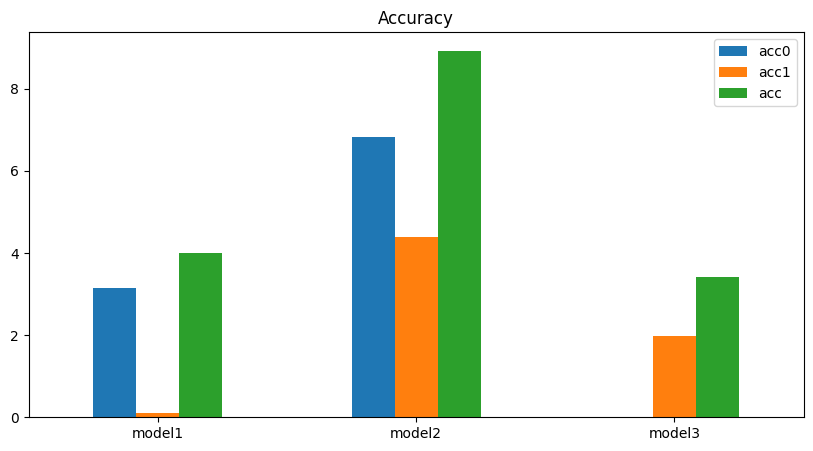

In [92]:
results.plot(kind='bar', figsize=(10, 5), rot=0, title="Accuracy")
plt.savefig('accuracy_test.png') 

In [27]:
import pandas as pd

# Specifica il percorso del tuo file di testo
percorso_file = 'train_modelli.txt'

# Usa pd.read_csv() specificando il separatore desiderato
# Ad esempio, se il tuo file è delimitato da spazi, puoi usare sep='\s+'
dataframe = pd.read_csv(percorso_file, sep='\s+', names=["modello", "epoch", "presence_acc", "class_acc", "iou", "loss"])

In [29]:
dataframe.head()

,modello,epoch,presence_acc,class_acc,iou,loss
0,model1,0,46.436657,56.732772,0.433508,0.017381
1,model1,1,42.533732,61.079417,0.451033,0.015801
2,model1,2,55.700444,60.862085,0.444439,0.016205
3,model1,3,25.373540,63.180295,0.480809,0.016019
4,model1,4,47.677262,60.164810,0.459842,0.016443


In [30]:
dataframe.groupby("modello").mean()

,epoch,presence_acc,class_acc,iou,loss
modello,,,,,
model1,9.5,34.291406,63.800598,0.521734,0.014846
model2,9.5,77.044281,62.434574,0.586346,0.014767
model3,9.5,52.423255,53.346011,0.487220,0.018000


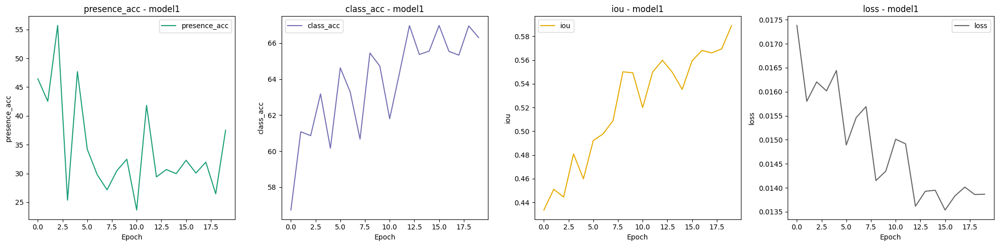

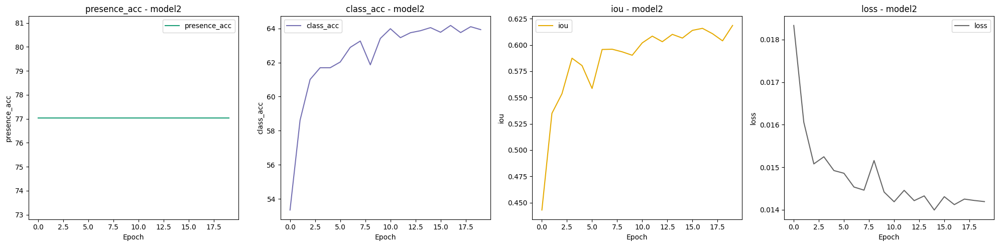

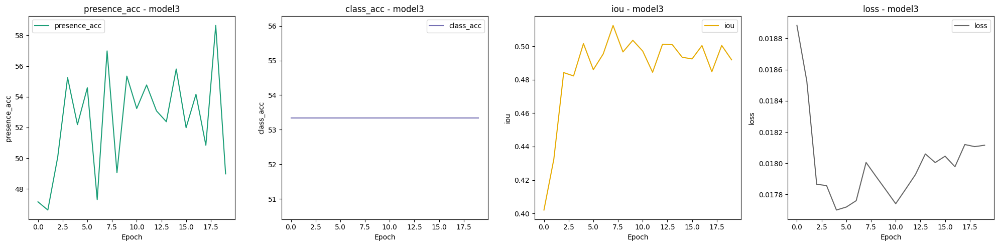

In [96]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Assicurati di avere il DataFrame 'dataframe' già caricato con i tuoi dati

# Lista dei modelli
modelli = dataframe["modello"].unique()

# Lista delle metriche da visualizzare
metriche = ["presence_acc", "class_acc", "iou", "loss"]

# Definisci una colormap
colormap = plt.cm.get_cmap('Dark2', len(metriche))

# Itera sui modelli e le metriche per generare i plot
for modello in modelli:
    # Filtra il DataFrame per il modello corrente
    df_modello = dataframe[dataframe["modello"] == modello]

    # Crea una figura con una griglia di subplot orizzontali
    fig, axs = plt.subplots(1, len(metriche), figsize=(5 * len(metriche), 5))
    
    # Itera sulle metriche per generare i singoli plot
    for i, Y in enumerate(metriche):
        color = colormap(i)
        axs[i].plot(df_modello["epoch"], df_modello[Y], color=color, label=Y)
        axs[i].set_title(f"{Y} - {modello}")
        axs[i].set_xlabel("Epoch")
        axs[i].set_ylabel(Y)
        axs[i].legend()
    
    # Aggiungi spazi tra i subplot
    plt.tight_layout()

    plt.savefig(f'{modello}_train.png') 
    
    # Visualizza la figura
    plt.show()
